<a href="https://colab.research.google.com/github/arpanbiswas52/PaperNotebooks/blob/main/LatentBO_jrVAE_PlasmonicNano(Notebook).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A Latent Bayesian Optimization Approach for High Dimensional Hyperparameter Tuning: Towards Enhancing the Joint (rotationally-invariant) Variational Auto-Encoder


---
Here we work with a joint (rotationally-invariant) VAE that can perform unsupervised classification and disentangle relevant continuous factors of variation at the same time.

Then the Latent BO is fitted with jrVAE for high dimensional hyperparameter optimal tuning

We will be using the experimental dataset on plasmonic nanoparticles from Muammer Yaman (UW Chemistry, Ginger Group). The datasets contain correlated scattering spectra of gold particles and scanning electron microscope images.

---


jrVAE model prepared by Maxim Ziatdinov

Latent BO (BO architecture, Colab Workflow) prepared by Arpan Biswas

E-mail: ziatdinovmax@gmail.com

E-mail: arpanbiswas52@gmail.com

In [1]:
#@title Installation
!pip install -q pyroved kornia
!pip install botorch #version 0.5.1
!pip install gpytorch #version 1.6.0
!pip install pyroved
!pip install atomai==0.5.2 > /dev/null
!pip install smt

     |████████████████████████████████| 46 kB 2.1 MB/s 
     |████████████████████████████████| 512 kB 25.1 MB/s 
     |████████████████████████████████| 718 kB 54.5 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 363 kB 16.5 MB/s 
     |████████████████████████████████| 310 kB 64.9 MB/s 
     |████████████████████████████████| 713 kB 70.8 MB/s 
  Created wheel for gpytorch: filename=gpytorch-1.6.0-py2.py3-none-any.whl size=509889 sha256=9911ccf7856f1879fc4ab3d4cc726049a631ba17eac537c59ed3520dd5e3fe3f
  Stored in directory: /root/.cache/pip/wheels/66/b5/89/34c06ad393a6feb72b4cdde46d0f1c667f3e2632960f9df109
Successfully built gpytorch
  Attempting uninstall: pyro-ppl
    Found existing installation: pyro-ppl 1.8.1
    Uninstalling pyro-ppl-1.8.1:
      Successfully uninstalled pyro-ppl-1.8.1
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Lo

In [2]:
#@title Imports
from typing import Tuple

import pyroved as pv
import torch
import kornia as K
import kornia.metrics as metrics
from torchvision import datasets
import matplotlib.pyplot as plt
import numpy as np
import random

# Import GP and BoTorch functions
import gpytorch as gpt
from botorch.models import SingleTaskGP, ModelListGP
#from botorch.models import gpytorch
from botorch.fit import fit_gpytorch_model
from botorch.models.gpytorch import GPyTorchModel
from botorch.utils import standardize
from gpytorch.distributions import MultivariateNormal
from gpytorch.kernels import ScaleKernel, RBFKernel, MaternKernel
from gpytorch.likelihoods import GaussianLikelihood
from gpytorch.means import ConstantMean, LinearMean
from gpytorch.mlls import ExactMarginalLogLikelihood
from botorch.acquisition import UpperConfidenceBound
from botorch.optim import optimize_acqf
from botorch.acquisition import qExpectedImprovement
from botorch.acquisition import ExpectedImprovement
from botorch.sampling import IIDNormalSampler
from botorch.sampling import SobolQMCNormalSampler
from gpytorch.likelihoods.likelihood import Likelihood
from gpytorch.constraints import GreaterThan

from botorch.generation import get_best_candidates, gen_candidates_torch
from botorch.optim import gen_batch_initial_conditions

from gpytorch.models import ExactGP
from mpl_toolkits.axes_grid1 import make_axes_locatable
#from smt.sampling_methods import LHS
from torch.optim import SGD
from torch.optim import Adam
from scipy.stats import norm
from scipy.interpolate import interp1d

#import atomai as aoi

from smt.sampling_methods import LHS

#import ipywidgets as widgets
#import pandas as pd
from skimage.transform import rescale, resize, downscale_local_mean
from skimage.transform import SimilarityTransform


In [3]:
#@title Helper functions

def func_periodic(x, params):
    y = params["A"] * np.exp(params["alpha"] * x) * np.cos(params["omega"] * x) + params["B"] * x
    return y

def generate_1Dspectra_Segment(degree, nsamples, num_traj) -> torch.Tensor:
   
    dataset = []
    points = []
    slopes = []

    for i in range(nsamples):

        x = np.linspace(-1, 1, num_traj)
        segment_x = np.array([-1]+list(sorted(np.random.uniform(-1, 1, degree)))+[1])
        segment_y = np.random.uniform(0, 1, degree+2)
        points.append(torch.from_numpy(segment_x))

        slope = np.zeros(degree+1)
        for j in range(len(slope)):
          slope[j] = (segment_y[j+1]-segment_y[j])/(segment_x[j+1]-segment_x[j])
        slope = torch.from_numpy(slope)

        f2 = interp1d(segment_x, segment_y, kind='linear')
        f2 = f2(x)
        f2 = torch.from_numpy(f2).type(torch.float)
        #noise = torch.randint(0, 50, (1,)) / 1e3
        noise = 0 # no noise

        data_t = f2 + noise * torch.randn(size=(len(x),))
        dataset.append(data_t)
        slopes.append(slope)

    dataset = torch.cat(dataset).reshape(nsamples,num_traj)
    points = torch.cat(points).reshape(nsamples, degree+2)
    slopes = torch.cat(slopes).reshape(nsamples, degree+1)

    # dataset = (dataset - dataset.min()) / (dataset.max() - dataset.min())
    return dataset, points, slopes

  # Utility functions for plasmonic image analysis
  #@title Customize Function

## Customize Functions are needed for Hyperspectral image  analysis 

def interactive_hyperimage(image, w=(400,1000,2)):

  '''
  input: 
  image: 3D Hyperspectral image
  w: wavelength, which is desired interval
  format is (starting wavenumber, ending wavenumber, step). Default is full spectrum, which is (400,1000,2) 

  output:
  interactive 2D image of hyperspectral image at desired wavelength

  '''

  def update(a):
    wl=int((a-400)/2)
    fig, ax = plt.subplots(figsize=(6,6))
    clr=ax.imshow(image[ :, :,wl])
    ax.set_title('Wavelength '+str(a)+' $\mathregular{nm}$', fontsize=24)
    fig.colorbar(clr,ax=ax) 
    

  

  return widgets.interact(update, a=w)

def get_stack_sem_images(df,index_pos=4, window_size=96,):
  '''
  input:
  df: Dataframe contain all data
  index_pos:position of the data, which need to stack
  window_size=certain size to resize of image with resize func

  output:
  image_stack_new: stack of SEM images

  '''
  image_stack_new = np.zeros((window_size,window_size))
  for i in range(df.shape[1]):
    col_name=df.columns[i]
    sem_data=df[col_name][index_pos]
    resized_sem_data = resize(sem_data, (window_size,window_size), anti_aliasing=False)
    image_stack_new = np.dstack((image_stack_new, resized_sem_data))

  image_stack_new = image_stack_new[:,:,1:]
  image_stack_new = np.swapaxes(image_stack_new, 0, 2)

  return image_stack_new

def filter_calibration_spec(spec,filter_nm=100, ):
  subst_spec=spec
  #normalize filter one (400-600nm) with filter two (600-1000nm)
  subst_spec[filter_nm:]=subst_spec[filter_nm:]*subst_spec[filter_nm-1:filter_nm].mean()/subst_spec[filter_nm:filter_nm+1].mean()
  
  return subst_spec  

def get_stack_hypercubes(df,index_pos=10, x_window_size=8,y_window_size=8):
  '''
  input:
  df: Dataframe contain all data
  index_pos:position of the data, which need to stack
  x_window_size,y_window_size= the size of the output hypercubes

  output:
  feature_arr_new: stack of hypercubes

  '''
  # Array to store cookies
  feature_arr_new= np.expand_dims(np.zeros((x_window_size, y_window_size, 301)),axis = 0)
  # feature_arr_new=np.zeros((x_window_size, y_window_size, 301))
  for i in range(df.shape[1]):
    col_name=df.columns[i]
    hyper_data=df[col_name][index_pos]
    x_start=(hyper_data.shape[0]-x_window_size)/2
    y_start=(hyper_data.shape[1]-x_window_size)/2
    one_hyper_data=hyper_data[int(hyper_data.shape[0]/2-x_window_size/2):int(hyper_data.shape[0]/2+x_window_size/2),int(hyper_data.shape[1]/2-y_window_size/2):int(hyper_data.shape[1]/2+y_window_size/2),:]
    hyper_data_1=np.expand_dims(one_hyper_data, axis = 0)
      
    feature_arr_new = np.append(feature_arr_new, hyper_data_1, axis = 0)

  feature_arr_new= feature_arr_new[1:,:,:,:]

  return feature_arr_new

def get_stack_cluster_size(df,index_pos=5,):
  '''
  input:
  df: Dataframe contain all data
  index_pos:position of the data, which need to stack
  

  output:
  clus_stack_new: stack of cluster size

  '''
  clus_stack_new= []
  for i in range(df.shape[1]):
    col_name=df.columns[i]
    clust=df[col_name][index_pos]
    
    clus_stack_new = np.append(clus_stack_new, clust)

  clus_stack_new = clus_stack_new
  

  return clus_stack_new
  

def convertTuple(tup):
    str =  ''.join(tup)
    return str
def get_stack_cluster_shape_list(df,index_pos=6,):
  '''
  input:
  df: Dataframe contain all data
  index_pos:position of the data, which need to stack
  

  output:
  clus_stack_new: tuples fo the stack of cluster shape

  '''
  clus_stack_new= []
  for i in range(df.shape[1]):
    col_name=df.columns[i]
    clust=df[col_name][index_pos]
    # type(clust)
    # clust=[((clust))]
    clust=convertTuple(clust)
    # clus_stack_new.append(clust)
    if clust == 's':
      clust_num=1
    elif clust == 't':
      clust_num=7
    elif clust == 'p':
      clust_num=5
    elif clust == 'h':
      clust_num=6
    elif clust == 'ss':
      clust_num=2
    elif clust == 'sss':
      clust_num=3
    elif clust == 'ssss':
      clust_num=4
    else:
      clust_num=4.5
    clus_stack_new.append(clust_num)
  clus_stack_new = clus_stack_new
  

  return clus_stack_new



def get_stack_cluster_shape(df,index_pos=6,):
  '''
  input:
  df: Dataframe contain all data
  index_pos:position of the data, which need to stack
  

  output:
  clus_stack_new: tuples fo the stack of cluster shape

  '''
  clus_stack_new= []
  for i in range(df.shape[1]):
    col_name=df.columns[i]
    clust=df[col_name][index_pos]
    # type(clust)
    # clust=[((clust))]
    clust=convertTuple(clust)
    clus_stack_new = np.append(clus_stack_new, clust)
    # clus_stack_new.append(clust)
  # clus_stack_new = clus_stack_new
  
  # clus_stack_new = np.append(clus_stack_new, clust)

  clus_stack_new = clus_stack_new

  return clus_stack_new


from scipy.signal import savgol_filter

def spectra_array_form (hyper_stack,x_window=4, y_window=4,filter_change=True, 
                        filter_nm=100, filter_smooth=True,window_length=7, polyorder=1):
  '''
  hyper_stack: hyper iamges as in shape[M,N,D]
  x_window,y_window:int  x,y window size to calculate the mean of area
  filter_smooth:Boolean If Ture, Apply a Savitzky-Golay filter to an array
  window_length:int The length of the filter window (i.e., the number of coefficients)
  polyorder: int The order of the polynomial used to fit the samples. polyorder must be less than window_length
 '''
  # Array to store images

  target_hyper = np.zeros((hyper_stack.shape[3]))


  for i in range(len(hyper_stack)):
      
      subst_spec=hyper_stack[i][int(x_window/2):int(-x_window/2),int(y_window/2):int(-y_window/2),:].mean(axis=(0,1))
      if filter_change==True:
        subst_spec=filter_calibration_spec(subst_spec,filter_nm)

      if filter_smooth== True:
        #Apply a Savitzky-Golay filter to an array
        subst_spec = savgol_filter(subst_spec,window_length, polyorder)

      target_hyper = np.column_stack((target_hyper,subst_spec ))
      

  target_hyper = target_hyper[:, 1:].T
  return target_hyper

  def filter_calibration_hyper(hyper_stack,filter_nm=100,):
    '''
    output:
    create hyper image by adjusting spectrum when the filter change
    input:
    hyper_stck: 3D hyper_image 
    filter_nm= int wavelength when filter change '''
    X_h=hyper_stack.shape[0]
    Y_h=hyper_stack.shape[1]
    Z_h=hyper_stack.shape[2]
    new_hyper_stack=np.zeros((X_h,Y_h,Z_h))
    for ix in range(X_h):
      for iy in range(Y_h):
        subst_spec=hyper_stack[ix,iy,:]
        #normalize filter one (400-600nm) with filter two (600-1000nm)
        subst_spec[filter_nm:]=subst_spec[filter_nm:]*subst_spec[filter_nm-1:filter_nm].mean()/subst_spec[filter_nm:filter_nm+1].mean()
        new_hyper_stack[ix,iy,:]=subst_spec
    return new_hyper_stack

#Now we start Analysis- Plasmonic Nano problem
- KL trajectory optimization using BO over the 2D latent space which decodes sample trajectory into real space.


Get training data and create a dataloader object

## SEM images stack

- Let's load the datacubes

In [ ]:
!pip install -U gdown
!gdown "https://drive.google.com/uc?id=1GF4XqQF2UwdZdEsbwloIsOLEPnC6Ciyp"
!gdown "https://drive.google.com/uc?id=11ilW01HKs1y8YtCmfxRbdJT7LsnDRf63"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Downloading...
From: https://drive.google.com/uc?id=1GF4XqQF2UwdZdEsbwloIsOLEPnC6Ciyp
To: /content/train_plas.npy
100% 24.1M/24.1M [00:00<00:00, 108MB/s]
Downloading...
From: https://drive.google.com/uc?id=11ilW01HKs1y8YtCmfxRbdJT7LsnDRf63
To: /content/plasmonic_labels.npy
100% 2.74k/2.74k [00:00<00:00, 3.87MB/s]


In [ ]:
imstack = np.load("train_plas.npy")
cluster_info = np.load("plasmonic_labels.npy")

In [ ]:
#Data Manipulation- We convert the data as binary mode to focus on the particles and zero padding on the outside area
#data = np.zeros((imstack.shape))
#for i in range(0, len(imstack)):
#  normdata = (imstack[i,:,:]-np.min(imstack[i,:,:]))/(np.max(imstack[i,:,:]) - np.min(imstack[i,:,:]))
#  for j in range(0, imstack.shape[1]):
#    for k in range(0, imstack.shape[2]):
#      if (normdata[j, k] >=0.5):
#        data[i, j, k] = 1
#      else:
#        data[i, j, k] = 0

#Data Manipulation- We normalize the data
data = np.zeros((imstack.shape))
for i in range(0, len(imstack)):
  normdata = (imstack[i,:,:]-np.min(imstack[i,:,:]))/(np.max(imstack[i,:,:]) - np.min(imstack[i,:,:]))
  data[i, :, :] = normdata


In [ ]:
data = np.reshape(data, (data.shape[0], 1, data.shape[1], data.shape[2]))
data = torch.from_numpy(data)
train_data = data.float()
print(train_data.shape,cluster_info.shape)

labels=cluster_info
for i in np.unique(labels):
    print("class {}, # of samples {}".format(i, len(labels[labels==i])))

torch.Size([327, 1, 96, 96]) (327,)
class 1.0, # of samples 188
class 2.0, # of samples 67
class 3.0, # of samples 38
class 4.0, # of samples 21
class 5.0, # of samples 7
class 6.0, # of samples 3
class 7.0, # of samples 3


In [ ]:
tc1 = train_data[labels==1]
tc2 = train_data[labels==2]
tc3 = train_data[labels==3]
tc4 = train_data[labels==4]
tc5 = train_data[labels==5]
tc6 = train_data[labels==6]
tc7 = train_data[labels==7]
print(tc1.shape, tc2.shape, tc3.shape, tc4.shape, tc5.shape, tc6.shape, tc7.shape)

# Resampling the data by adding noise with more weights to minority group for balanced data
#noise =  torch.rand(188, 1, 96, 96)*0.1 #scale the noise to unif[0, 0.1]
noise =  torch.normal(mean=0, std= 0.1, size= (1, 96, 96))
print(noise.shape)

torch.Size([188, 1, 96, 96]) torch.Size([67, 1, 96, 96]) torch.Size([38, 1, 96, 96]) torch.Size([21, 1, 96, 96]) torch.Size([7, 1, 96, 96]) torch.Size([3, 1, 96, 96]) torch.Size([3, 1, 96, 96])
torch.Size([1, 96, 96])


In [ ]:
#@title Augment dataset (unbalanced data)
labels_class1 = torch.zeros((tc1.shape[0])) + 1
labels_class2 = torch.zeros((tc2.shape[0])) + 2
labels_class3 = torch.zeros((tc3.shape[0])) + 3
train_syndata = torch.vstack((tc1, tc2, tc3))
labels_syndata = torch.hstack((labels_class1, labels_class2, labels_class3))
#Random shuffling the dataset
idx= np.random.choice(len(train_syndata), len(train_syndata), replace=False)
train_syndata = train_syndata[idx]
labels_syndata = labels_syndata[idx]
print(train_syndata.shape, labels_syndata.shape)

torch.Size([293, 1, 96, 96]) torch.Size([293])


In [ ]:
#@title Augment dataset (balanced data)
n_datapoints = 10000
#Adding synthetic data (noise)
#Class 1
train_class1 = torch.empty((n_datapoints, 1, tc1.shape[2], tc1.shape[3]))
labels_class1 = torch.zeros((n_datapoints)) + 1
train_class1[0: len(tc1), :, :, :] = tc1
pts1 = torch.randint(0, len(tc1), (n_datapoints-len(tc1),))
for i in range(0, n_datapoints-len(tc1)):
  #noise =  torch.rand(1, tc1.shape[2], tc1.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.1, size= (1, tc1.shape[2], tc1.shape[3]))
  noise = 0
  train_class1[len(tc1) + i, :, :, :] = tc1[pts1[i]] + noise

#Class 2
train_class2 = torch.empty((n_datapoints, 1, tc2.shape[2], tc2.shape[3]))
labels_class2 = torch.zeros((n_datapoints)) + 2
train_class2[0: len(tc2), :, :, :] = tc2
pts2 = torch.randint(0, len(tc2), (n_datapoints-len(tc2),))
for i in range(0, n_datapoints-len(tc2)):
  #noise =  torch.rand(1, tc2.shape[2], tc2.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.05, size= (1, tc2.shape[2], tc2.shape[3]))
  noise = 0
  train_class2[len(tc2) + i, :, :, :] = tc2[pts2[i]] + noise

#Class 3
train_class3 = torch.empty((n_datapoints, 1, tc3.shape[2], tc3.shape[3]))
labels_class3 = torch.zeros((n_datapoints)) + 3
train_class3[0: len(tc3), :, :, :] = tc3
pts3 = torch.randint(0, len(tc3), (n_datapoints-len(tc3),))
for i in range(0, n_datapoints-len(tc3)):
  #noise =  torch.rand(1, tc3.shape[2], tc3.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.01, size= (1, tc3.shape[2], tc3.shape[3]))
  noise = 0 
  train_class3[len(tc3) + i, :, :, :] = tc3[pts3[i]] + noise

# Augment dataset 
#Now we have a balanced data
train_syndata = torch.vstack((train_class1, train_class2, train_class3))
labels_syndata = torch.hstack((labels_class1, labels_class2, labels_class3))

#plt.imshow(train_syndata[4000,0,:,:])
#Random shuffling the dataset
idx= np.random.choice(len(train_syndata), len(train_syndata), replace=False)
train_syndata = train_syndata[idx]
labels_syndata = labels_syndata[idx]
print(train_syndata.shape, labels_syndata.shape)

torch.Size([30000, 1, 96, 96]) torch.Size([30000])


In [ ]:
# Check if the data is balanced now
for i in np.unique(labels_syndata):
    print("class {}, # of samples {}".format(i, len(labels_syndata[labels_syndata==i])))

class 1.0, # of samples 10000
class 2.0, # of samples 10000
class 3.0, # of samples 10000


# Considering 3 labels (particles)

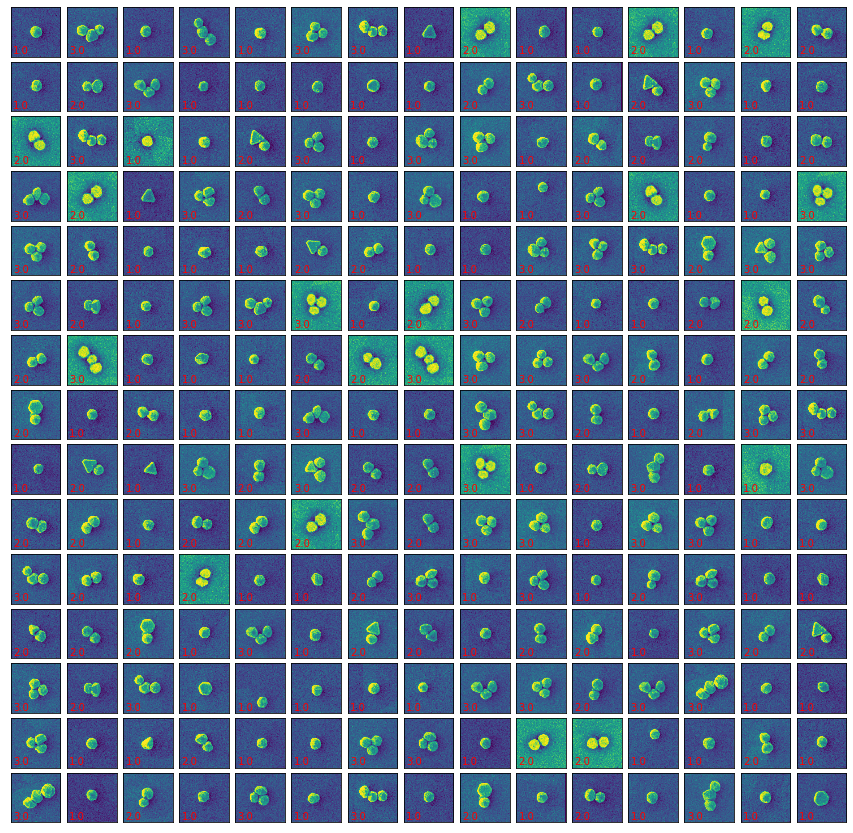

In [ ]:
#After normalization
fig, axes = plt.subplots(15, 15, figsize=(15, 15),
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

#for ax, im in zip(axes.flat, train_data):
#    ax.imshow(im.squeeze(), cmap='viridis', interpolation='nearest')
for ax, im, lbl in zip(axes.flat, train_syndata, labels_syndata):
    ax.imshow(im.squeeze(), cmap='viridis', interpolation='nearest')
    ax.text(0.05, 0.05, str(lbl.item()),
            transform=ax.transAxes, color='red')

plt.savefig('TD_plasmonic.png')
plt.show()

Result of BO optimization after run in SDGX box

- We optimze the kl factor, kl_c
- We set the other hyperparameters as below

- Invariance = ['r']
- Gaussian decoder sampler with sigma = 0.01
- kl_d = 0.01
- lr =1e-4

- We run the final jrVAE model with the optimized kl_c

# Optimal trajectory from zBO model (run in SDGX box)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Downloading...
From: https://drive.google.com/uc?id=1srRCKkeK1PMOrC_2VfLbkRsfkZQ5S28R
To: /content/kl_cont_est_opt.npy
100% 928/928 [00:00<00:00, 1.18MB/s]


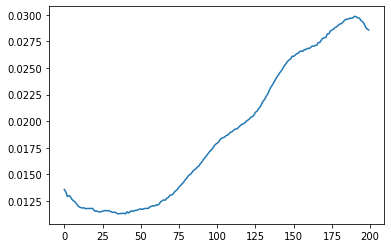

In [ ]:
!pip install -U gdown
!gdown "https://drive.google.com/uc?id=1srRCKkeK1PMOrC_2VfLbkRsfkZQ5S28R"

kl_optimal_est = np.load("kl_cont_est_opt.npy")
kl_optimal_est = torch.from_numpy(kl_optimal_est)
#print(kl_optimal_est)
plt.plot(kl_optimal_est)

/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Manifold training at iter: 20


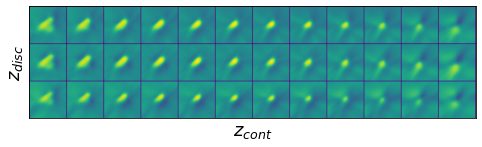

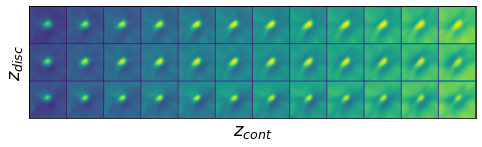

Manifold training at iter: 40


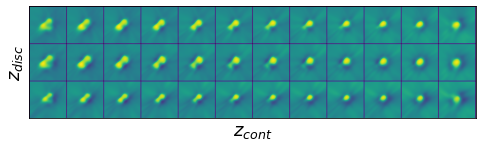

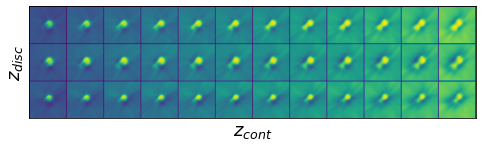

Manifold training at iter: 60


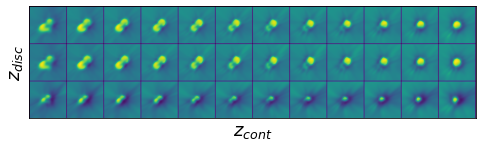

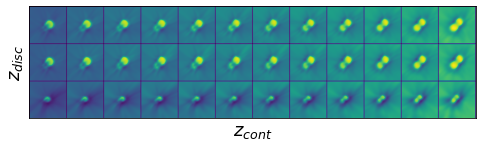

Manifold training at iter: 80


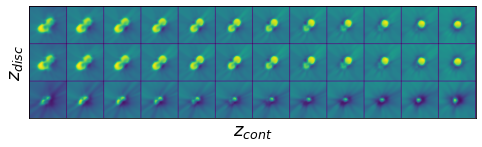

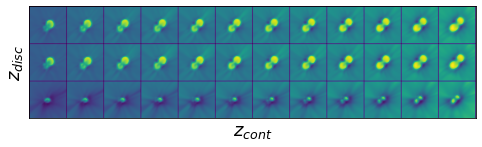

Manifold training at iter: 100


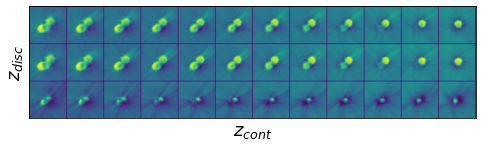

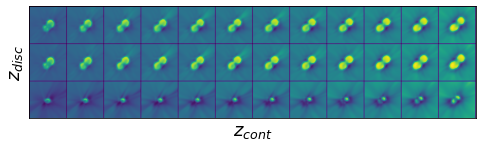

Manifold training at iter: 120


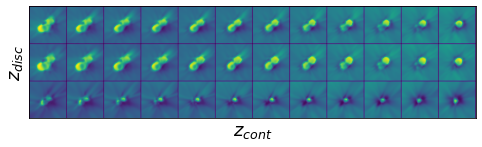

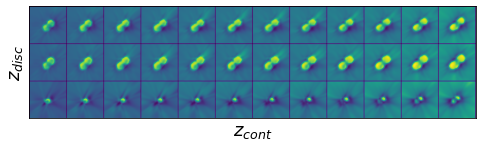

Manifold training at iter: 140


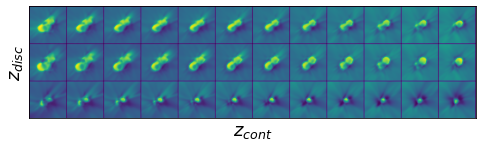

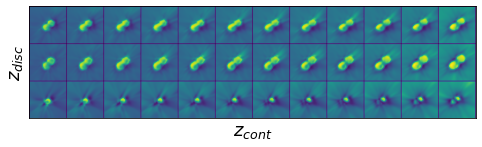

Manifold training at iter: 160


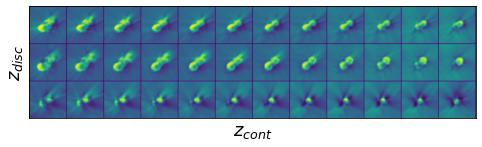

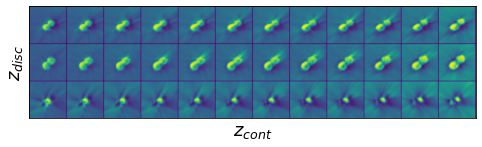

Manifold training at iter: 180


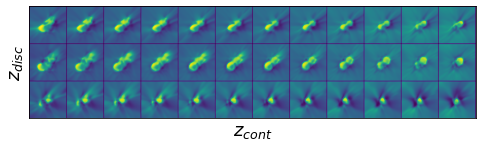

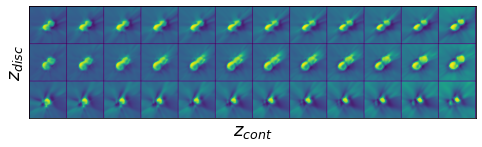

Manifold training at iter: 200


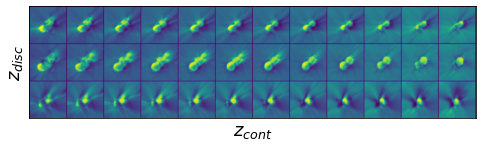

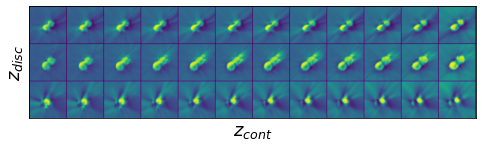

In [ ]:
#@title Train the VAE model- use the optimized kl trajectory from zBO
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 3 #We dont have any prior knowledge with the actual # of discrete class of defects, we initialize arbitarily and changes which seems best fit with learning (classification) with VAE model
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=['r'], sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

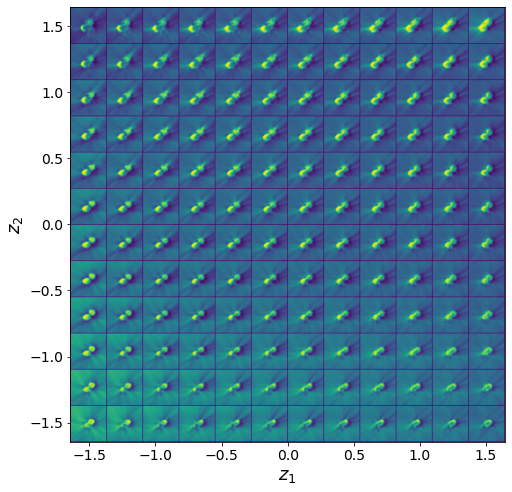

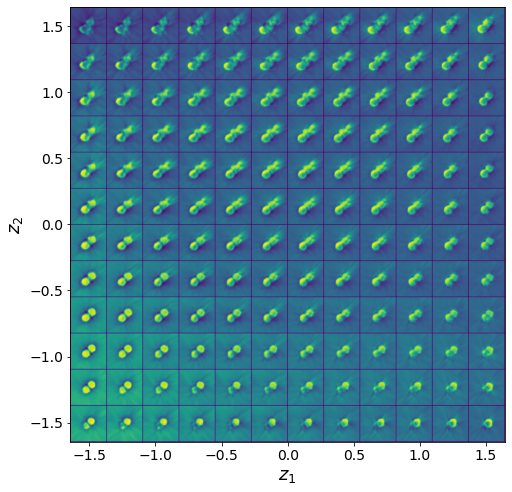

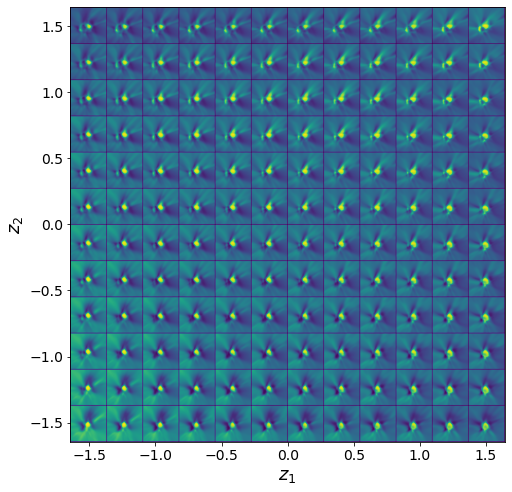

In [ ]:
M_full = torch.empty(B*B, H, W, discrete_dim)
loss_opt = 0
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

Manifold training at iter: 20


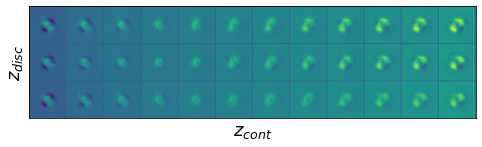

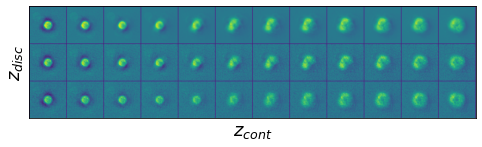

Manifold training at iter: 40


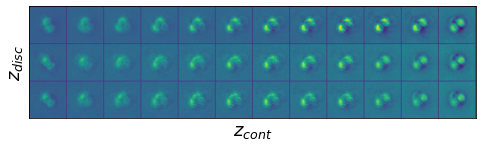

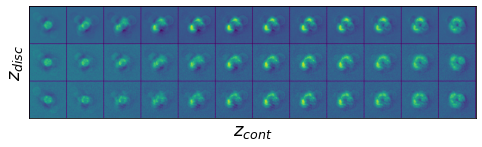

Manifold training at iter: 60


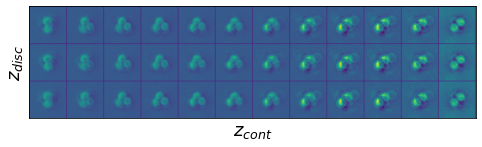

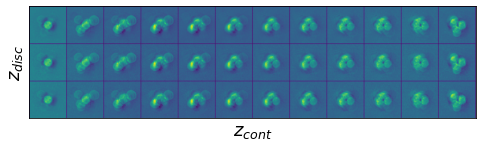

Manifold training at iter: 80


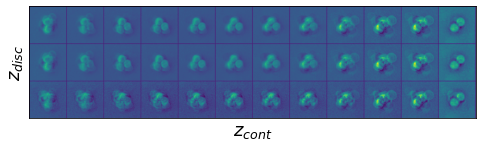

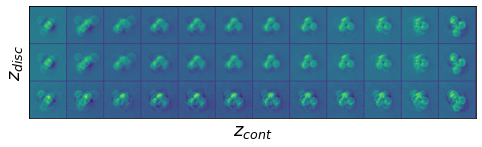

Manifold training at iter: 100


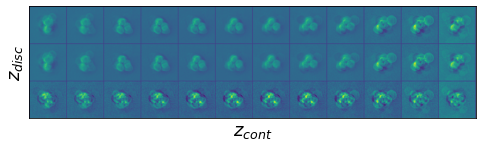

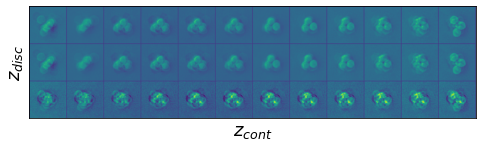

Manifold training at iter: 120


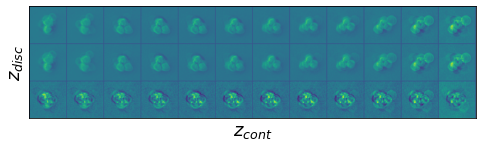

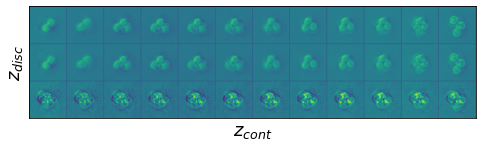

Manifold training at iter: 140


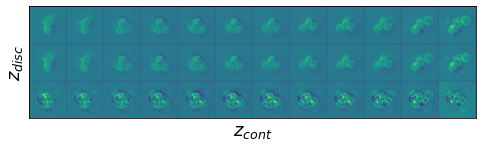

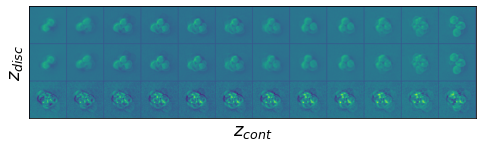

Manifold training at iter: 160


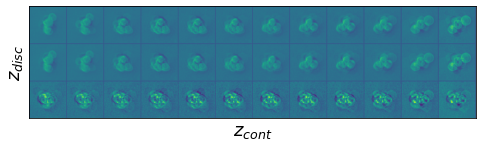

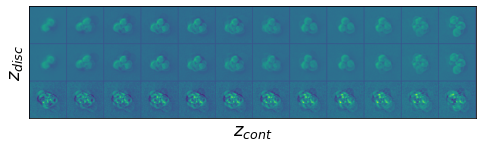

Manifold training at iter: 180


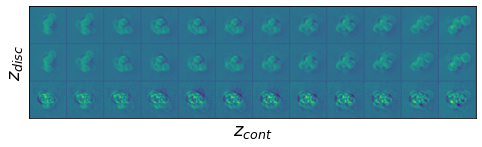

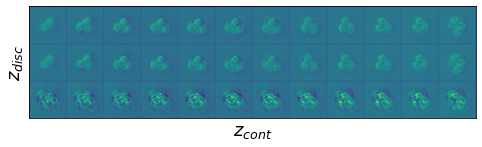

Manifold training at iter: 200


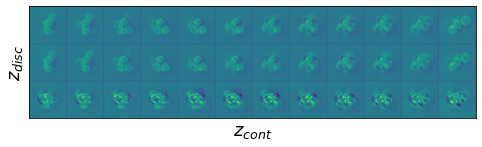

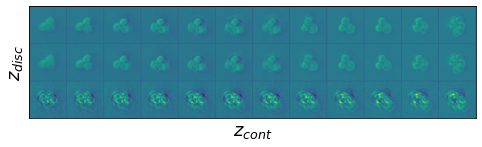

In [ ]:
#@title Train the  vanilla VAE model
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 3 #We dont have any prior knowledge with the actual # of discrete class of defects, we initialize arbitarily and changes which seems best fit with learning (classification) with VAE model
kl_d = 1

train_loader_full = pv.utils.init_dataloader(train_syndata, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=None, sampler_d='gaussian', seed=42, decoder_sig = 0.1, sigmoid_d=False )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

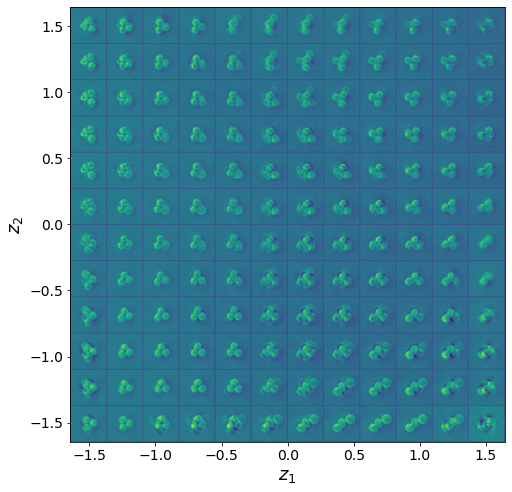

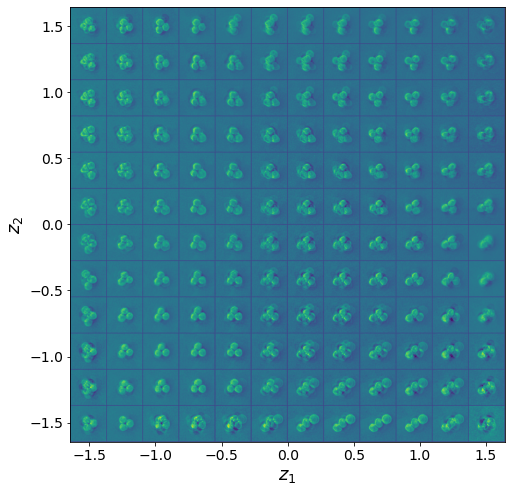

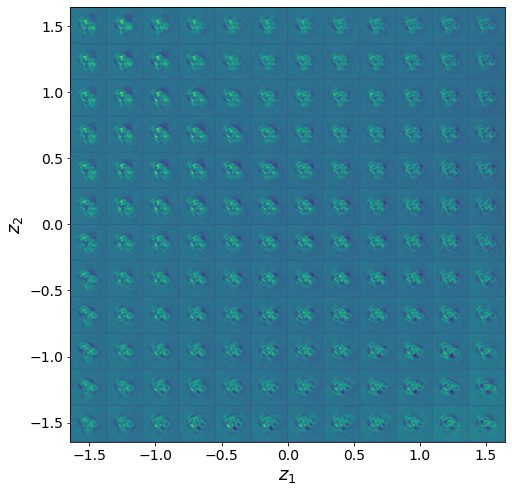

In [ ]:
M_full = torch.empty(B*B, H, W, discrete_dim)
loss_opt = 0
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

Manifold training at iter: 20


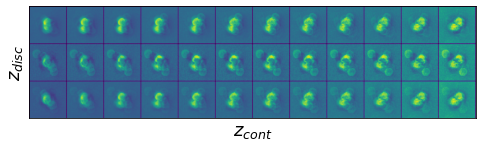

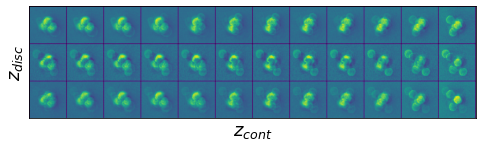

Manifold training at iter: 40


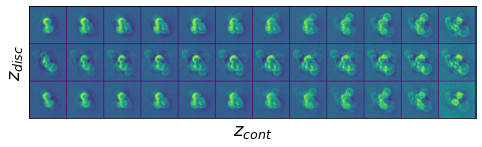

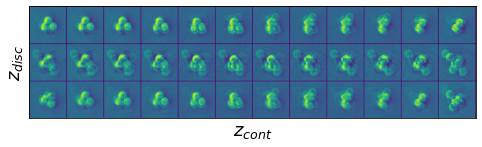

Manifold training at iter: 60


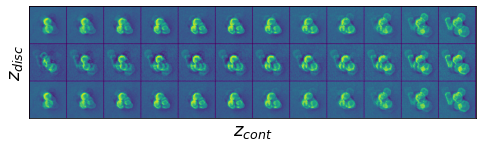

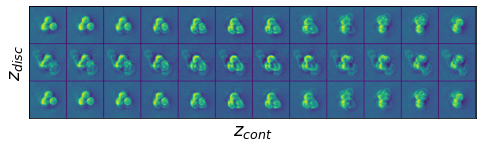

Manifold training at iter: 80


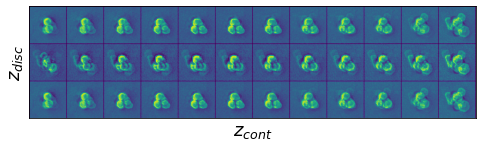

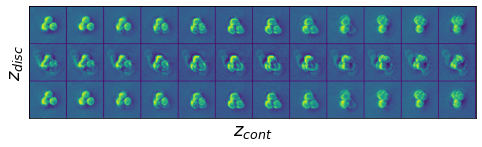

Manifold training at iter: 100


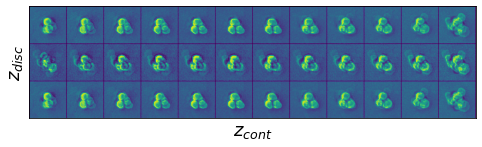

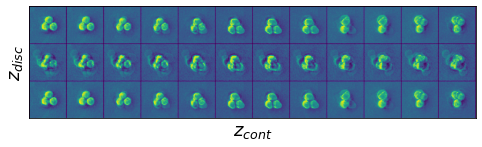

Manifold training at iter: 120


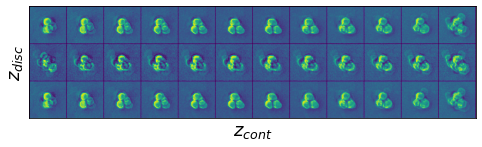

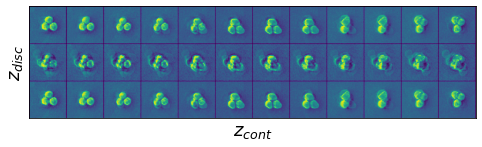

Manifold training at iter: 140


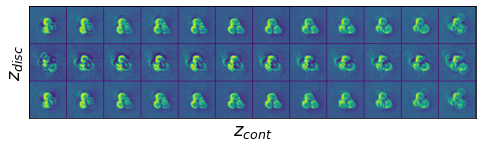

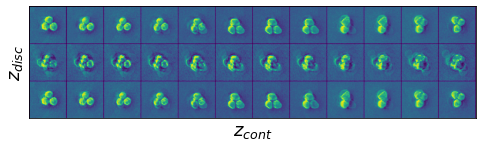

Manifold training at iter: 160


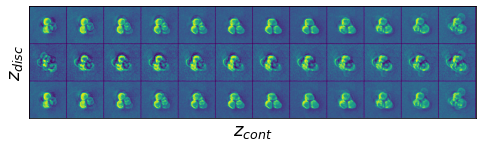

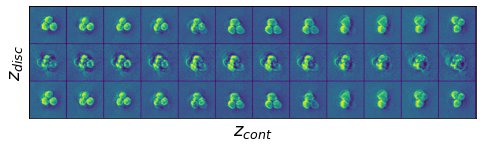

Manifold training at iter: 180


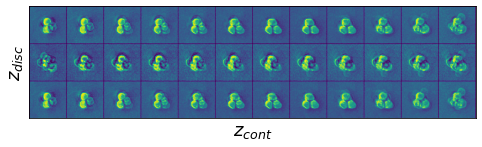

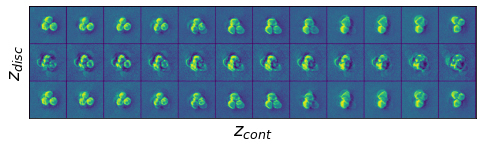

Manifold training at iter: 200


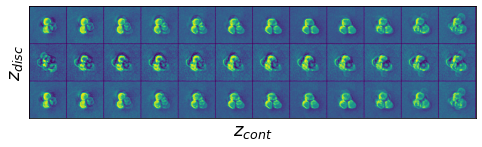

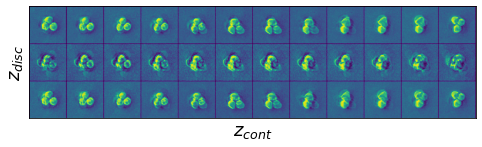

In [ ]:
#@title Train the vanilla VAE model- with hyperparam tweaking
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 3 #We dont have any prior knowledge with the actual # of discrete class of defects, we initialize arbitarily and changes which seems best fit with learning (classification) with VAE model
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=None, sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

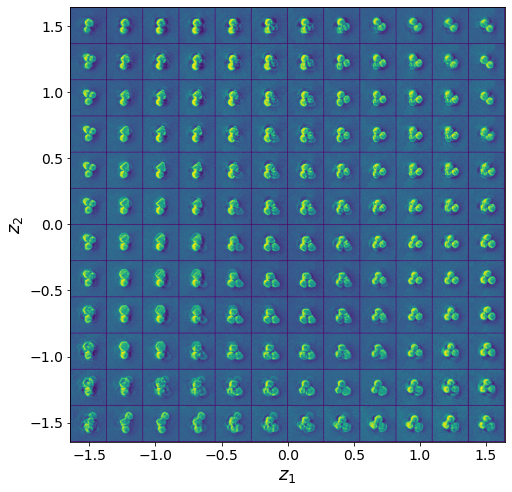

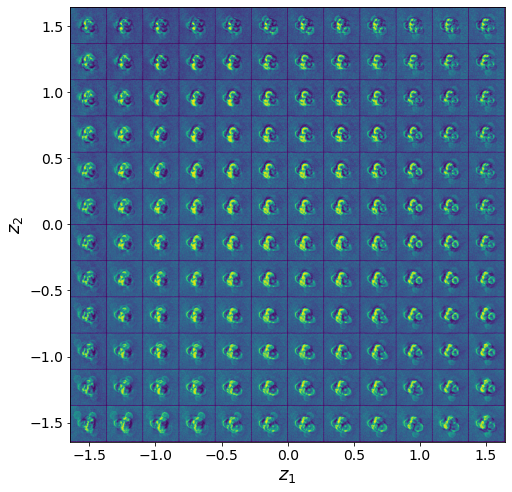

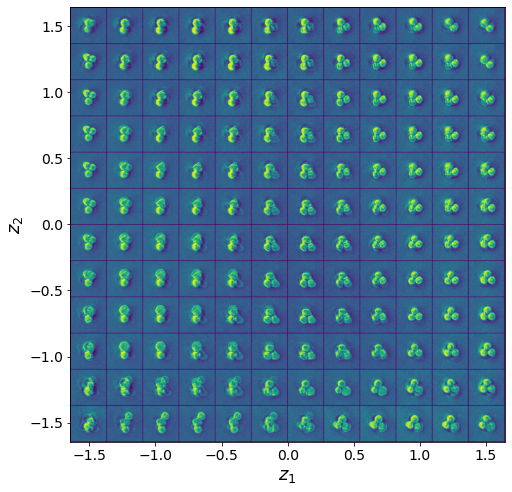

In [ ]:
M_full = torch.empty(B*B, H, W, discrete_dim)
loss_opt = 0
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Manifold training at iter: 20


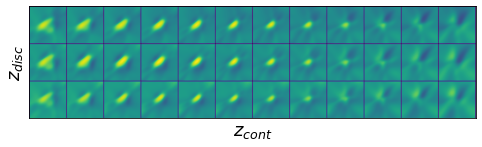

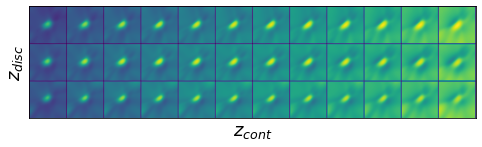

Manifold training at iter: 40


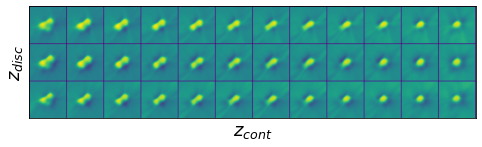

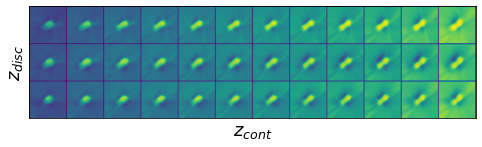

Manifold training at iter: 60


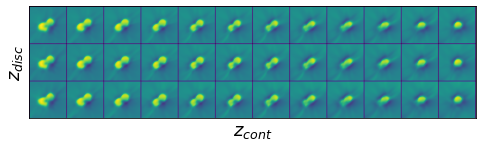

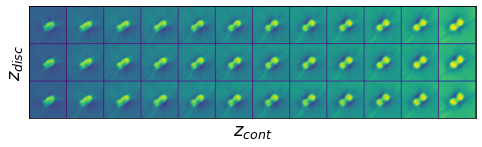

Manifold training at iter: 80


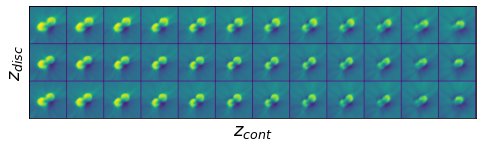

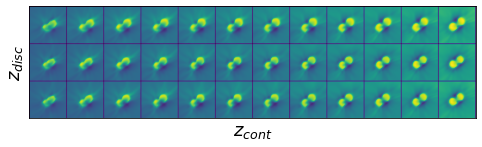

Manifold training at iter: 100


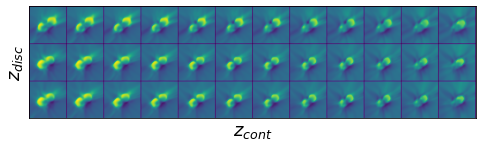

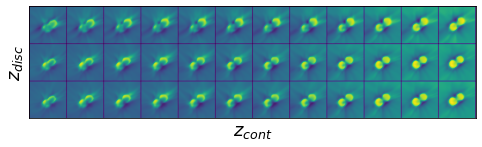

Manifold training at iter: 120


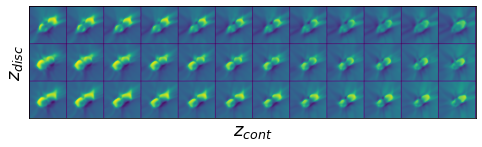

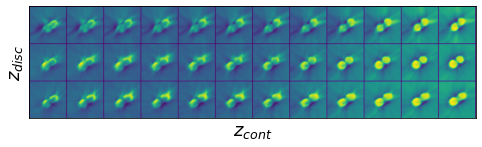

Manifold training at iter: 140


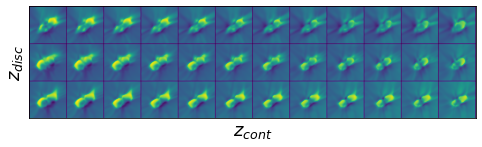

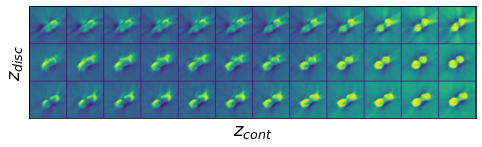

Manifold training at iter: 160


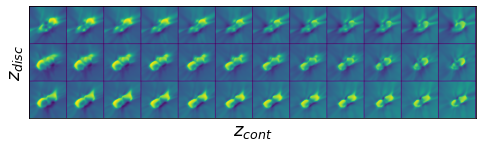

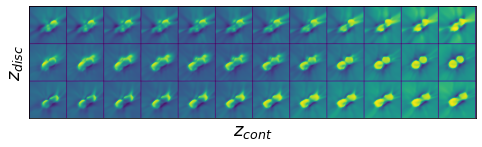

Manifold training at iter: 180


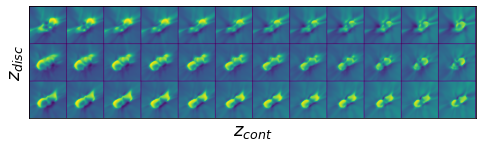

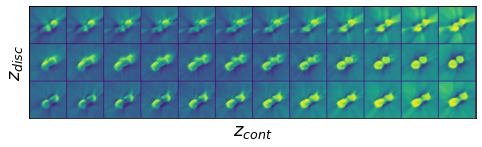

Manifold training at iter: 200


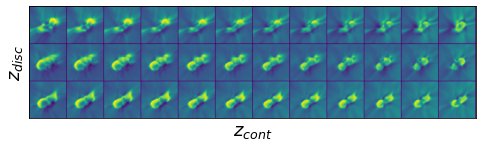

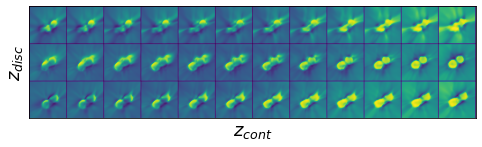

In [ ]:
#@title Train the jr-VAE model- use default kl_c
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 3 #We dont have any prior knowledge with the actual # of discrete class of defects, we initialize arbitarily and changes which seems best fit with learning (classification) with VAE model
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=['r'], sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

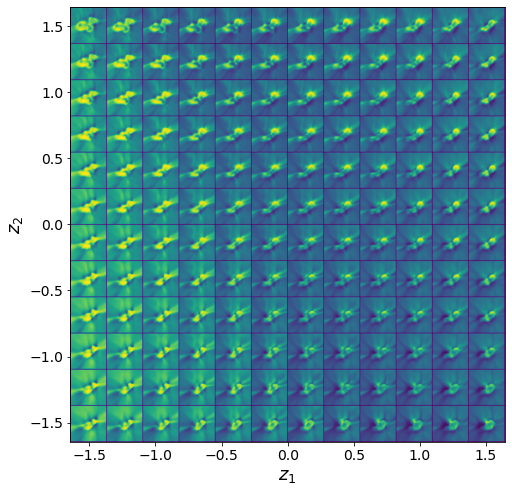

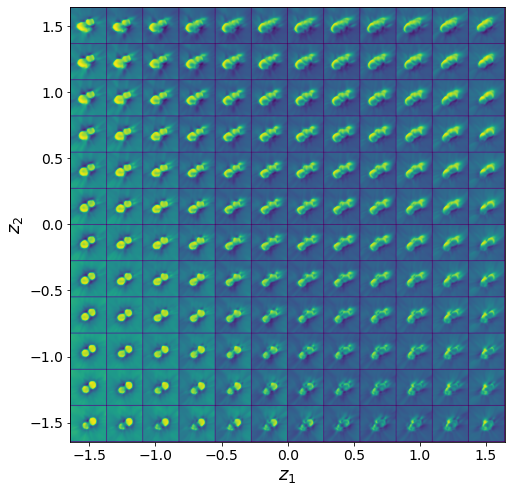

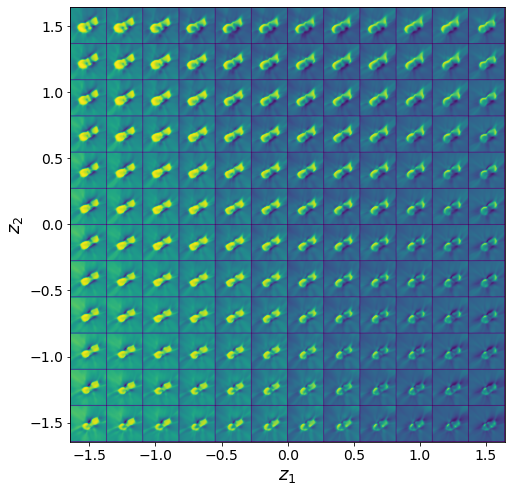

In [ ]:
M_full = torch.empty(B*B, H, W, discrete_dim)
loss_opt = 0
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

#Testing with optimal solution in MNIST analysis

To validate the sensitivity of the trajectory on a given problem


/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Manifold training at iter: 20


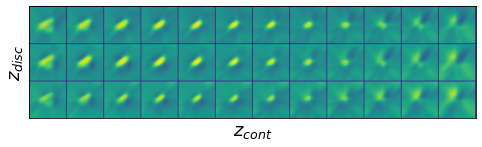

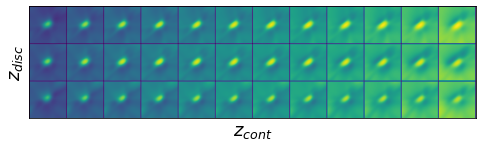

Manifold training at iter: 40


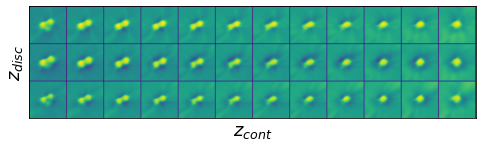

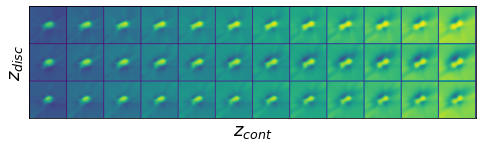

Manifold training at iter: 60


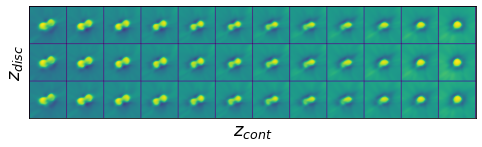

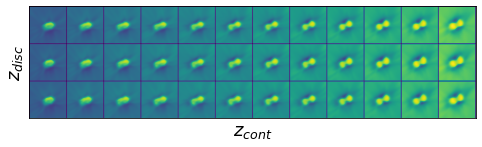

Manifold training at iter: 80


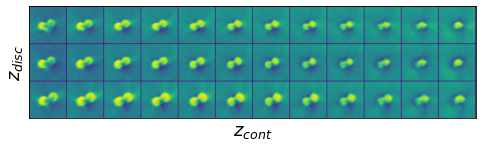

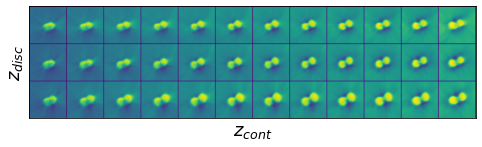

Manifold training at iter: 100


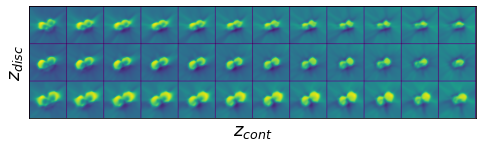

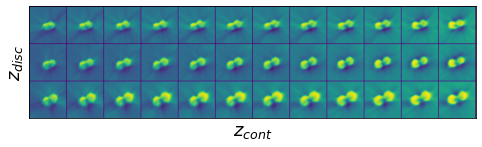

Manifold training at iter: 120


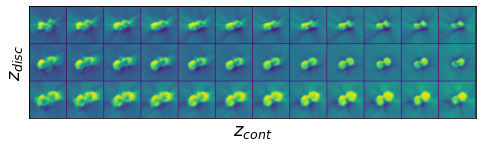

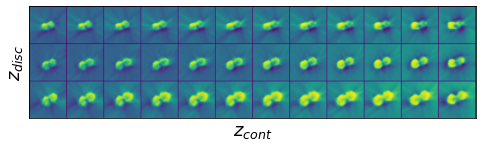

Manifold training at iter: 140


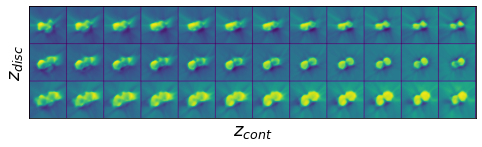

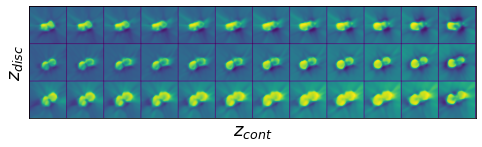

Manifold training at iter: 160


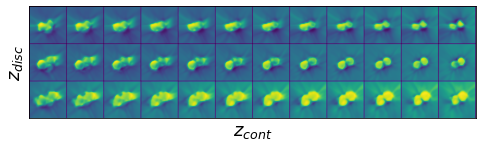

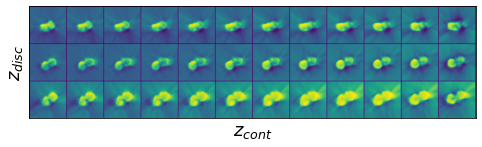

Manifold training at iter: 180


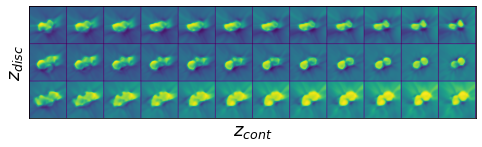

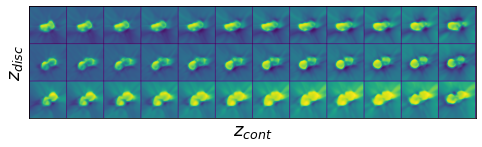

Manifold training at iter: 200


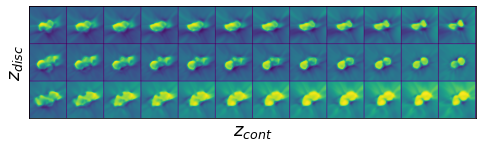

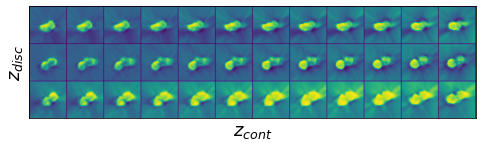

In [ ]:
#@title Train the VAE model
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 3 #We dont have any prior knowledge with the actual # of discrete class of defects, we initialize arbitarily and changes which seems best fit with learning (classification) with VAE model
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=['r'], sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

kl_c = torch.cat(  
    [torch.ones(18,) * 44,  # put pressure on the continuous latent channel at the beginning
    torch.linspace(44, 3, 60)]  # gradually release the pressure
)  


for e in range(200):
    sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    #sc = 0.01
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

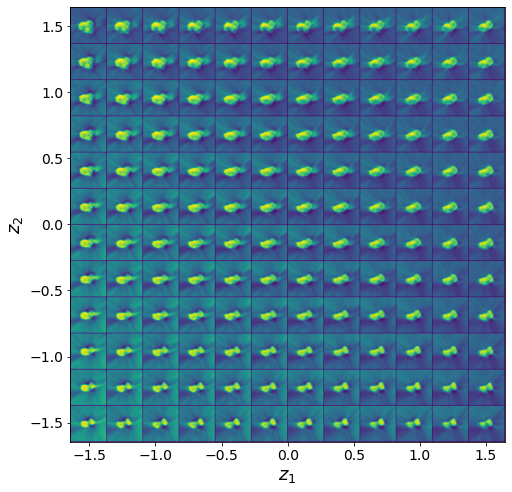

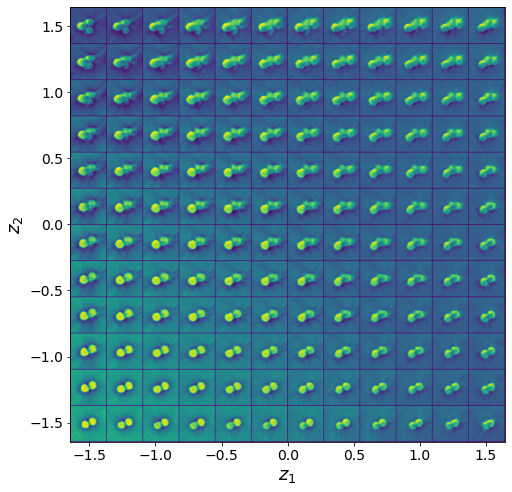

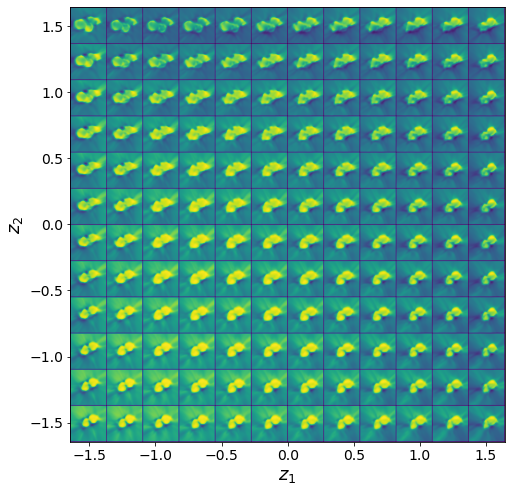

In [ ]:
M_full = torch.empty(B*B, H, W, discrete_dim)
loss_opt = 0
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

# Now consider full data - 7 labels

In [ ]:
#@title Augment dataset (balanced data for all labels)
n_datapoints = 5000
#Adding synthetic data (noise)
#Class 1
train_class1 = torch.empty((n_datapoints, 1, tc1.shape[2], tc1.shape[3]))
labels_class1 = torch.zeros((n_datapoints)) + 1
train_class1[0: len(tc1), :, :, :] = tc1
pts1 = torch.randint(0, len(tc1), (n_datapoints-len(tc1),))
for i in range(0, n_datapoints-len(tc1)):
  #noise =  torch.rand(1, tc1.shape[2], tc1.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.1, size= (1, tc1.shape[2], tc1.shape[3]))
  noise = 0
  train_class1[len(tc1) + i, :, :, :] = tc1[pts1[i]] + noise

#Class 2
train_class2 = torch.empty((n_datapoints, 1, tc2.shape[2], tc2.shape[3]))
labels_class2 = torch.zeros((n_datapoints)) + 2
train_class2[0: len(tc2), :, :, :] = tc2
pts2 = torch.randint(0, len(tc2), (n_datapoints-len(tc2),))
for i in range(0, n_datapoints-len(tc2)):
  #noise =  torch.rand(1, tc2.shape[2], tc2.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.05, size= (1, tc2.shape[2], tc2.shape[3]))
  noise = 0
  train_class2[len(tc2) + i, :, :, :] = tc2[pts2[i]] + noise

#Class 3
train_class3 = torch.empty((n_datapoints, 1, tc3.shape[2], tc3.shape[3]))
labels_class3 = torch.zeros((n_datapoints)) + 3
train_class3[0: len(tc3), :, :, :] = tc3
pts3 = torch.randint(0, len(tc3), (n_datapoints-len(tc3),))
for i in range(0, n_datapoints-len(tc3)):
  #noise =  torch.rand(1, tc3.shape[2], tc3.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.01, size= (1, tc3.shape[2], tc3.shape[3]))
  noise = 0 
  train_class3[len(tc3) + i, :, :, :] = tc3[pts3[i]] + noise

#Class 4
train_class4 = torch.empty((n_datapoints, 1, tc4.shape[2], tc4.shape[3]))
labels_class4 = torch.zeros((n_datapoints)) + 4
train_class4[0: len(tc4), :, :, :] = tc4
pts4 = torch.randint(0, len(tc4), (n_datapoints-len(tc4),))
for i in range(0, n_datapoints-len(tc4)):
  #noise =  torch.rand(1, tc3.shape[2], tc3.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.01, size= (1, tc3.shape[2], tc3.shape[3]))
  noise = 0 
  train_class4[len(tc4) + i, :, :, :] = tc3[pts4[i]] + noise

#Class 5
train_class5 = torch.empty((n_datapoints, 1, tc5.shape[2], tc5.shape[3]))
labels_class5 = torch.zeros((n_datapoints)) + 5
train_class5[0: len(tc5), :, :, :] = tc5
pts5 = torch.randint(0, len(tc5), (n_datapoints-len(tc5),))
for i in range(0, n_datapoints-len(tc5)):
  #noise =  torch.rand(1, tc3.shape[2], tc3.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.01, size= (1, tc3.shape[2], tc3.shape[3]))
  noise = 0 
  train_class5[len(tc5) + i, :, :, :] = tc5[pts5[i]] + noise

#Class 6
train_class6 = torch.empty((n_datapoints, 1, tc6.shape[2], tc6.shape[3]))
labels_class6 = torch.zeros((n_datapoints)) + 6
train_class6[0: len(tc6), :, :, :] = tc6
pts6 = torch.randint(0, len(tc6), (n_datapoints-len(tc6),))
for i in range(0, n_datapoints-len(tc6)):
  #noise =  torch.rand(1, tc3.shape[2], tc3.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.01, size= (1, tc3.shape[2], tc3.shape[3]))
  noise = 0 
  train_class6[len(tc6) + i, :, :, :] = tc6[pts6[i]] + noise

#Class 7
train_class7 = torch.empty((n_datapoints, 1, tc7.shape[2], tc7.shape[3]))
labels_class7 = torch.zeros((n_datapoints)) + 7
train_class7[0: len(tc7), :, :, :] = tc7
pts7 = torch.randint(0, len(tc7), (n_datapoints-len(tc7),))
for i in range(0, n_datapoints-len(tc7)):
  #noise =  torch.rand(1, tc3.shape[2], tc3.shape[3])*0.1
  #noise =  torch.normal(mean=0, std= 0.01, size= (1, tc3.shape[2], tc3.shape[3]))
  noise = 0 
  train_class7[len(tc7) + i, :, :, :] = tc7[pts7[i]] + noise
# Augment dataset 
#Now we have a balanced data
train_syndata_full = torch.vstack((train_class1, train_class2, train_class3, train_class4, train_class5, train_class6, train_class7))
labels_syndata_full = torch.hstack((labels_class1, labels_class2, labels_class3, labels_class4, labels_class5, labels_class6, labels_class7))

#plt.imshow(train_syndata[4000,0,:,:])
#Random shuffling the dataset
idx= np.random.choice(len(train_syndata_full), len(train_syndata_full), replace=False)
train_syndata_full = train_syndata_full[idx]
labels_syndata_full = labels_syndata_full[idx]
print(train_syndata_full.shape, labels_syndata_full.shape)

torch.Size([35000, 1, 96, 96]) torch.Size([35000])


In [ ]:
# Check if the data is balanced now
for i in np.unique(labels_syndata_full):
    print("class {}, # of samples {}".format(i, len(labels_syndata_full[labels_syndata_full==i])))

class 1.0, # of samples 5000
class 2.0, # of samples 5000
class 3.0, # of samples 5000
class 4.0, # of samples 5000
class 5.0, # of samples 5000
class 6.0, # of samples 5000
class 7.0, # of samples 5000


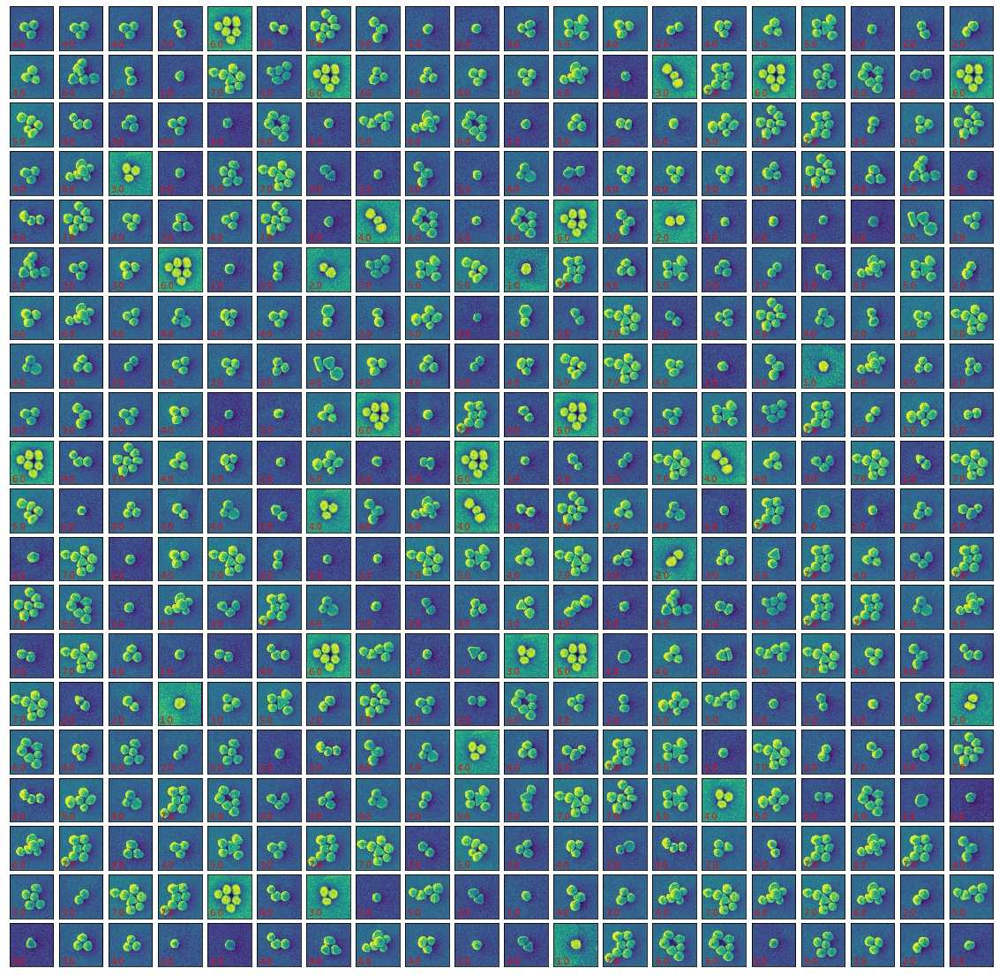

In [ ]:
#Considering all labels
fig, axes = plt.subplots(20, 20, figsize=(20, 20),
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

#for ax, im in zip(axes.flat, train_data):
#    ax.imshow(im.squeeze(), cmap='viridis', interpolation='nearest')
for ax, im, lbl in zip(axes.flat, train_syndata_full, labels_syndata_full):
    ax.imshow(im.squeeze(), cmap='viridis', interpolation='nearest')
    ax.text(0.05, 0.05, str(lbl.item()),
            transform=ax.transAxes, color='red')

plt.savefig('TD_plasmonic.png')
plt.show()

In [4]:
!pip install -U gdown
!gdown "https://drive.google.com/uc?id=13Dr9wZkrt6qvjXtwJ4ZX1XceKx1Z0TVz"


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Downloading...
From: https://drive.google.com/uc?id=13Dr9wZkrt6qvjXtwJ4ZX1XceKx1Z0TVz
To: /content/kl_cont_est_opt.npy
100% 928/928 [00:00<00:00, 1.38MB/s]


#Optimal traj

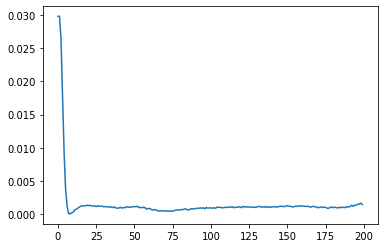

In [5]:
kl_optimal_est = np.load("kl_cont_est_opt.npy")
kl_optimal_est = torch.from_numpy(kl_optimal_est)
scale =1e-3
#print(kl_optimal_est)
plt.plot(kl_optimal_est*scale)
plt.savefig('KL'+str(1)+'.png')
plt.show()

In [ ]:
#@title Train the jr-VAE model- use the optimized kl trajectory from zBO
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 7
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata_full, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=['r'], sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    #sc = 0.01
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

Learned manifolds -- The code is trained in SDGX environment

# Learned manifolds for Latent Var 1

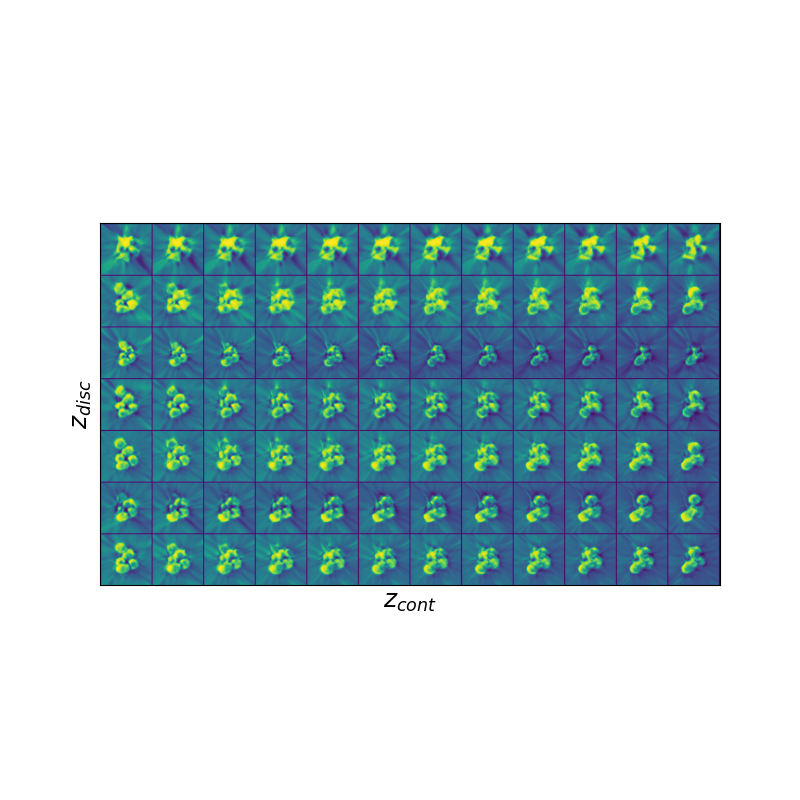

# Learned manifolds for Latent Var 2

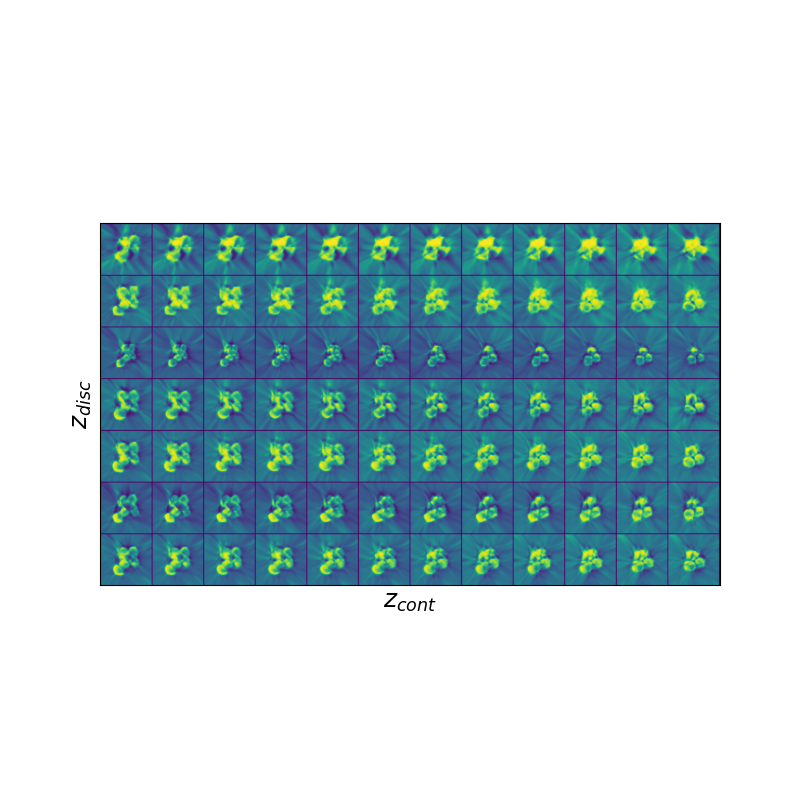

Manifold training at iter: 20


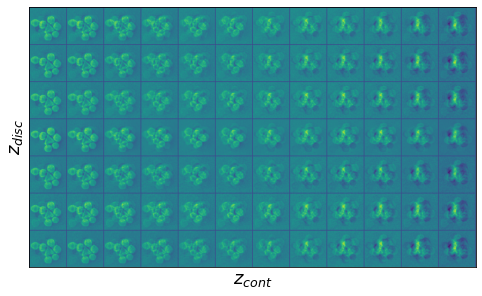

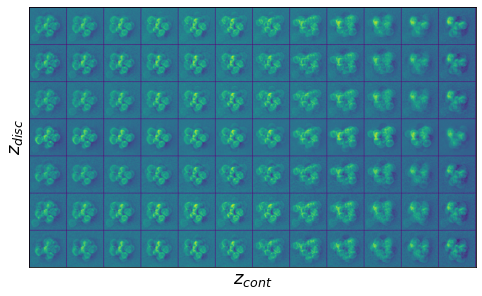

Manifold training at iter: 40


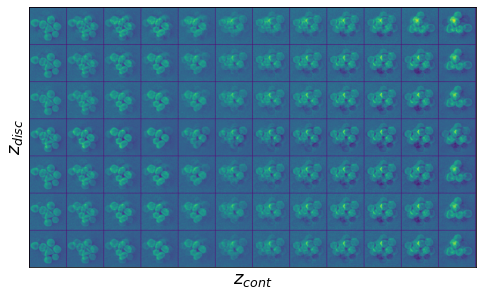

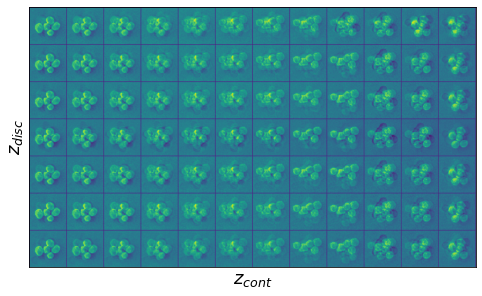

Manifold training at iter: 60


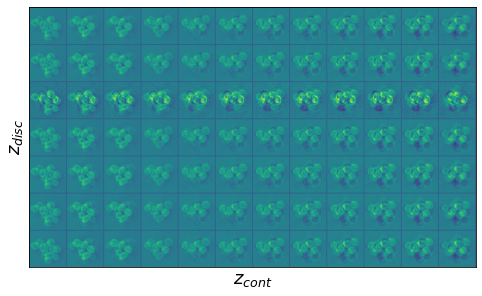

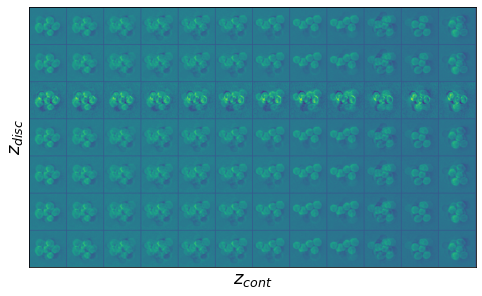

Manifold training at iter: 80


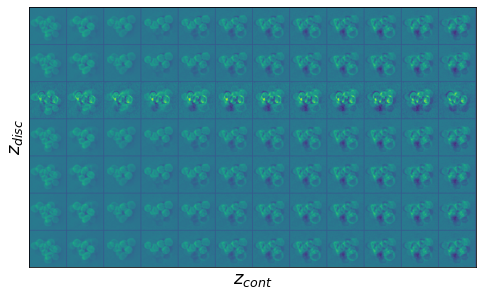

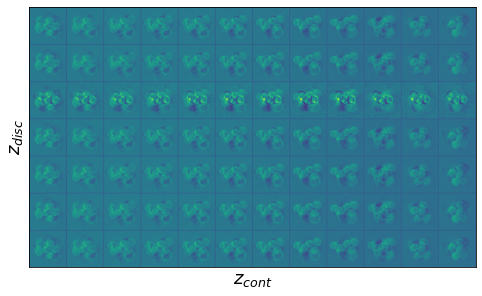

Manifold training at iter: 100


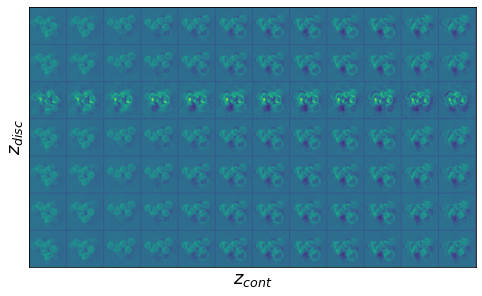

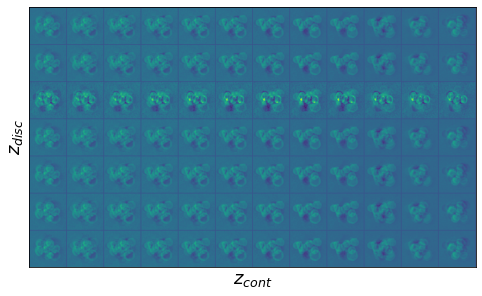

Manifold training at iter: 120


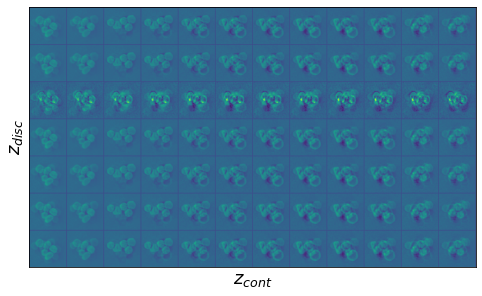

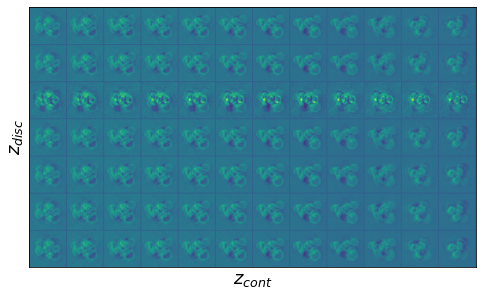

Manifold training at iter: 140


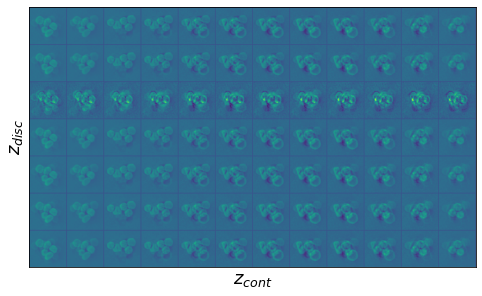

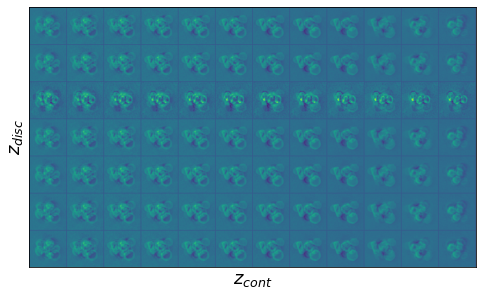

Manifold training at iter: 160


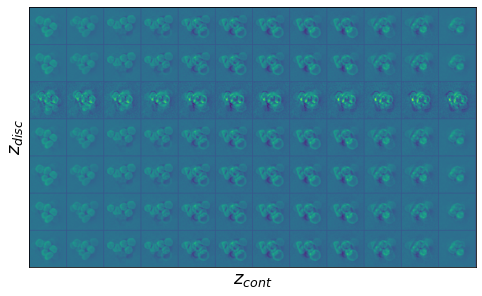

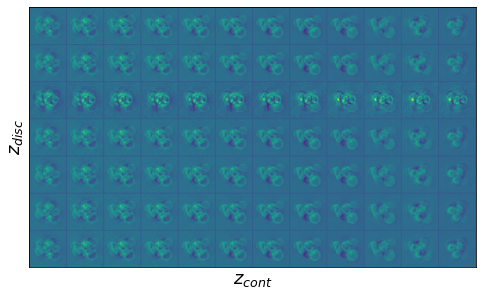

Manifold training at iter: 180


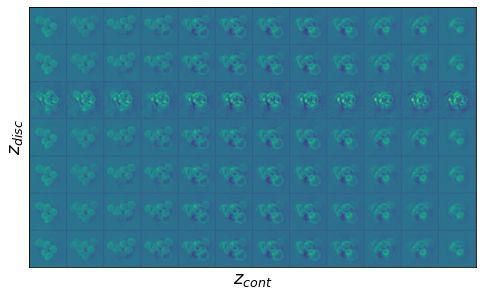

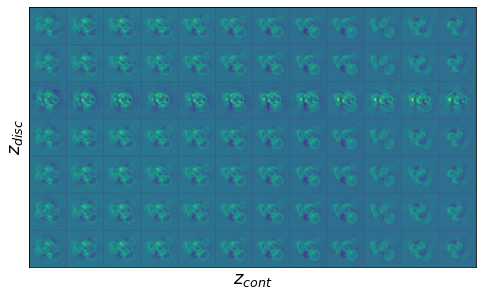

Manifold training at iter: 200


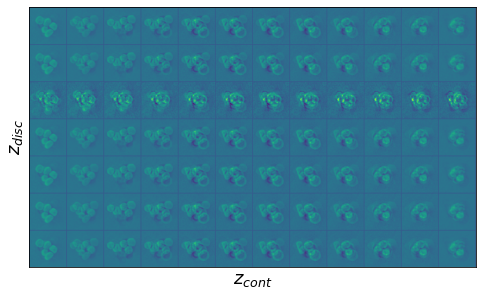

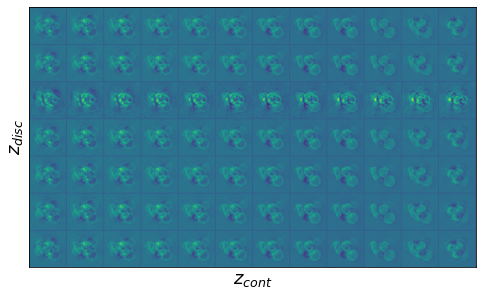

In [ ]:
#@title Train the  vanilla VAE model
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 7 
kl_d = 1

train_loader_full = pv.utils.init_dataloader(train_syndata_full, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=None, sampler_d='gaussian', seed=42, decoder_sig = 0.1, sigmoid_d=False )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

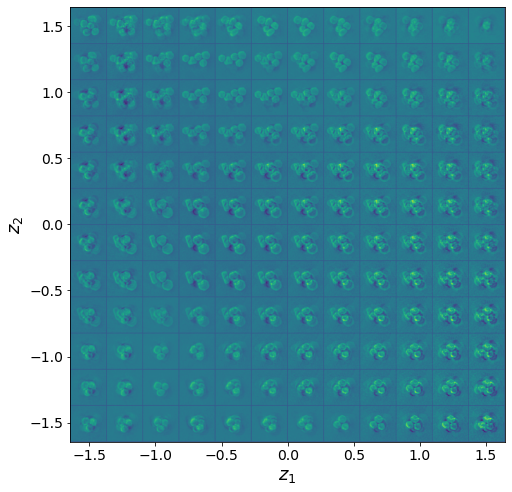

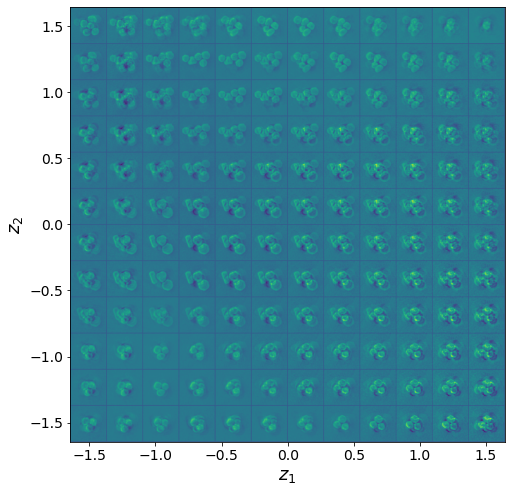

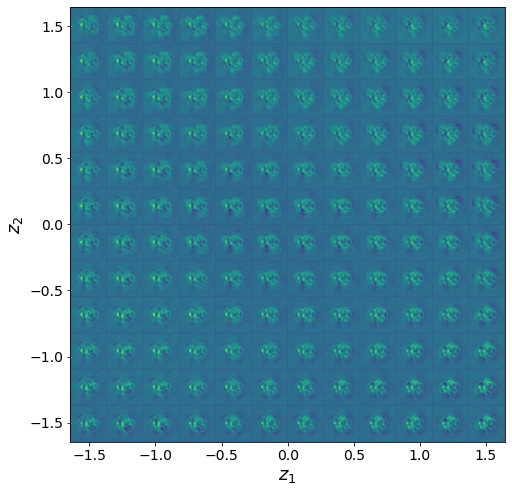

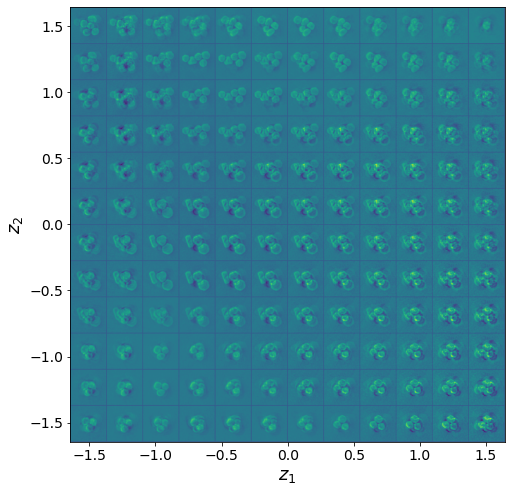

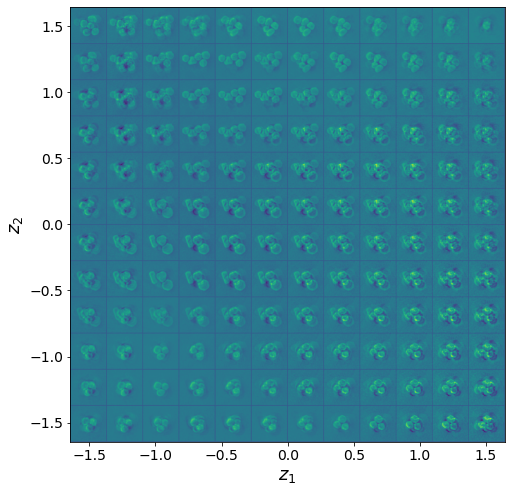

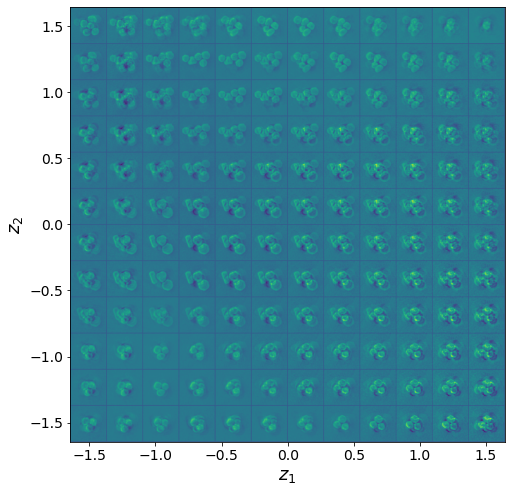

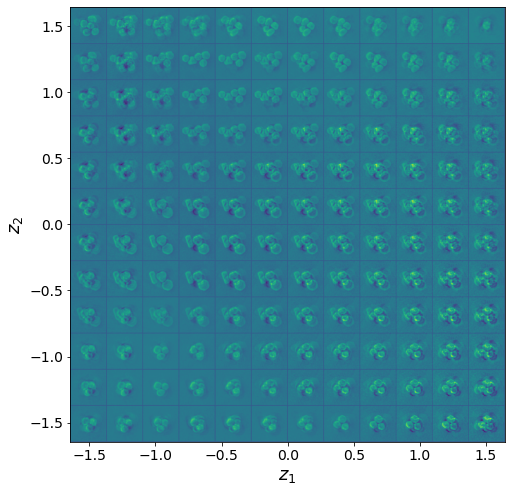

In [ ]:
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

Manifold training at iter: 20


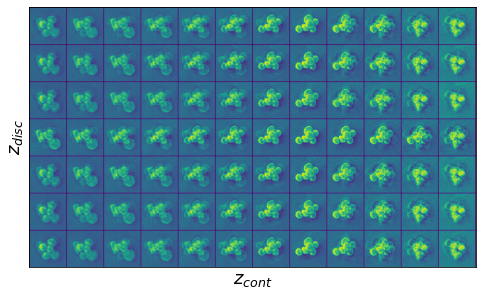

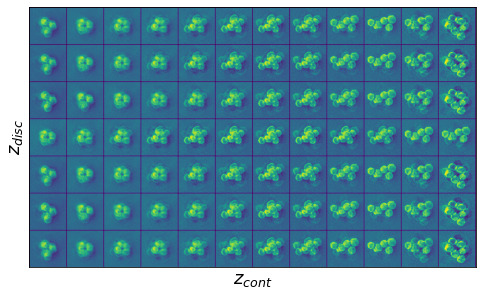

Manifold training at iter: 40


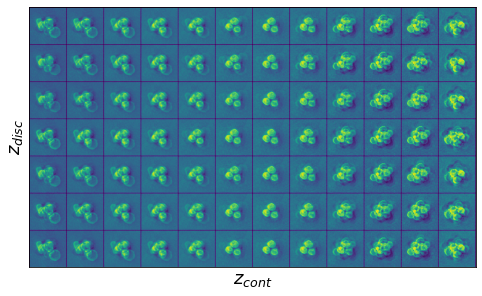

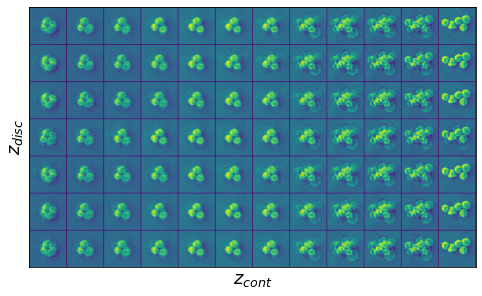

Manifold training at iter: 60


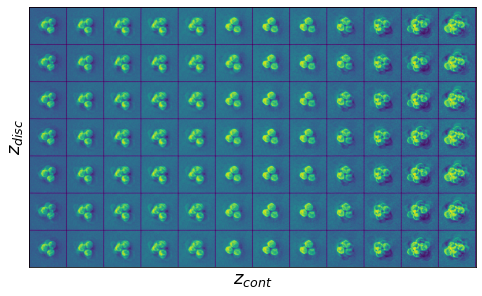

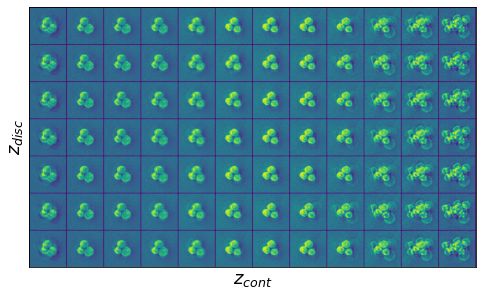

Manifold training at iter: 80


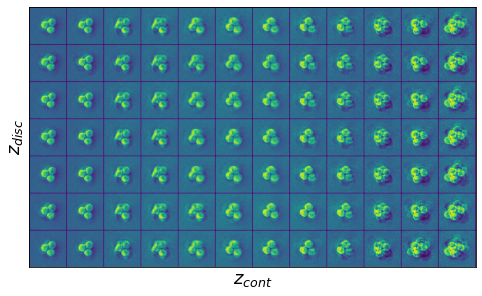

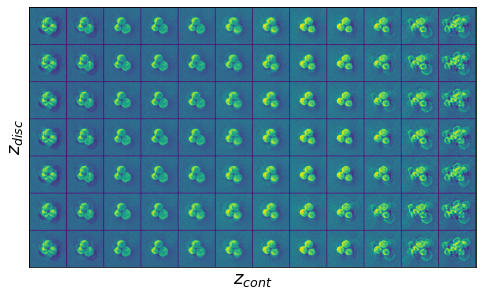

Manifold training at iter: 100


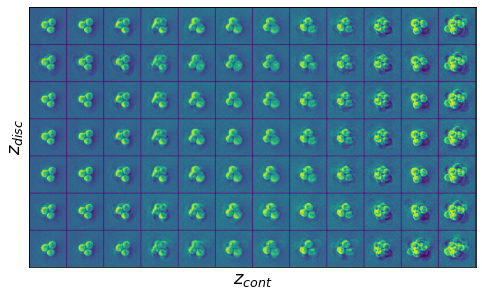

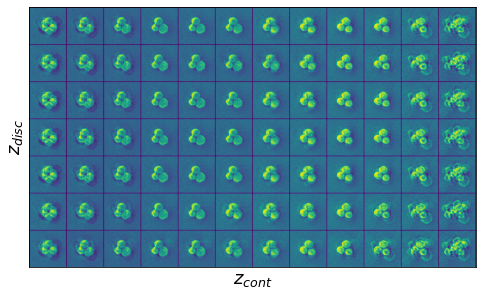

Manifold training at iter: 120


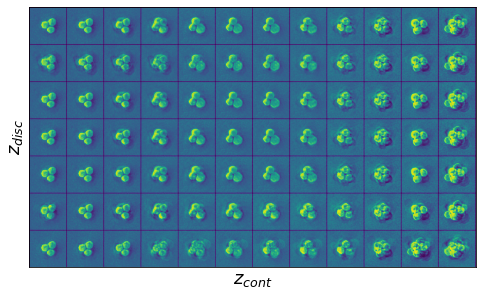

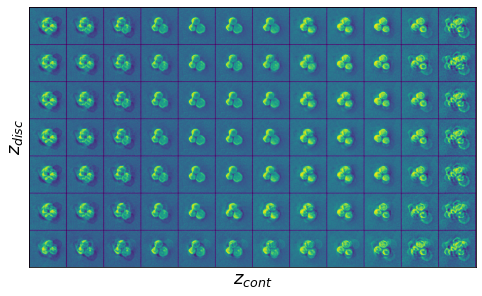

Manifold training at iter: 140


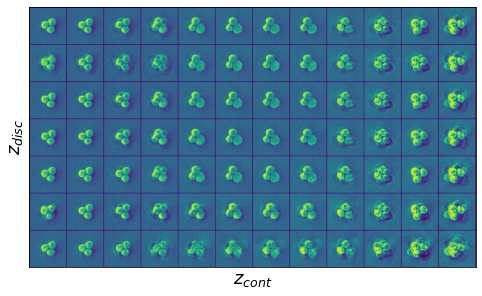

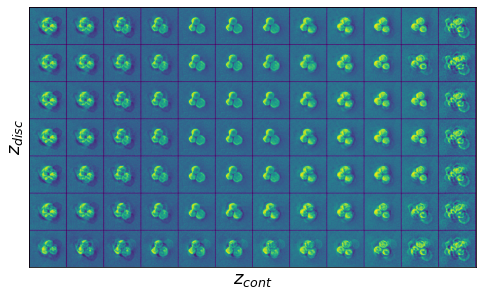

Manifold training at iter: 160


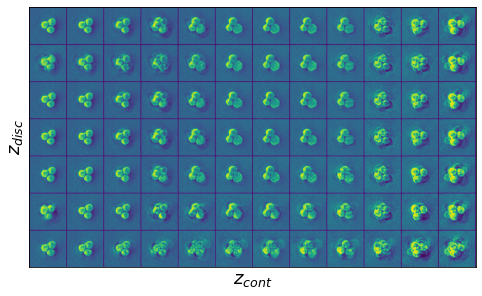

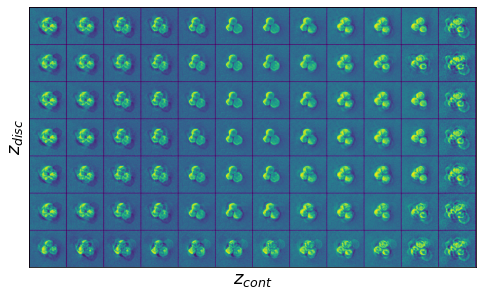

Manifold training at iter: 180


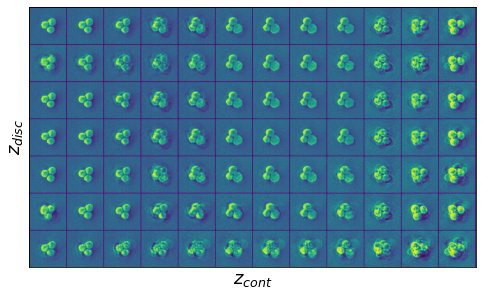

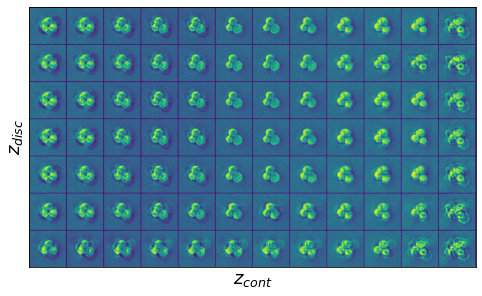

Manifold training at iter: 200


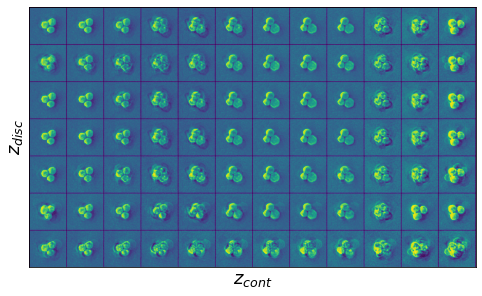

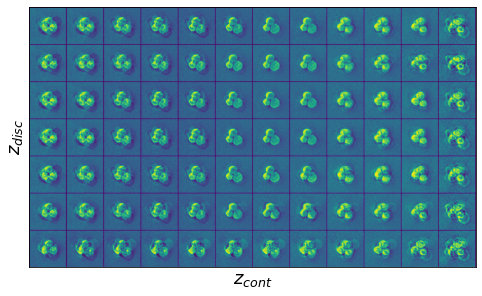

In [ ]:
#@title Train the vanilla VAE model- with hyperparam tweaking
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 7
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata_full, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=None, sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

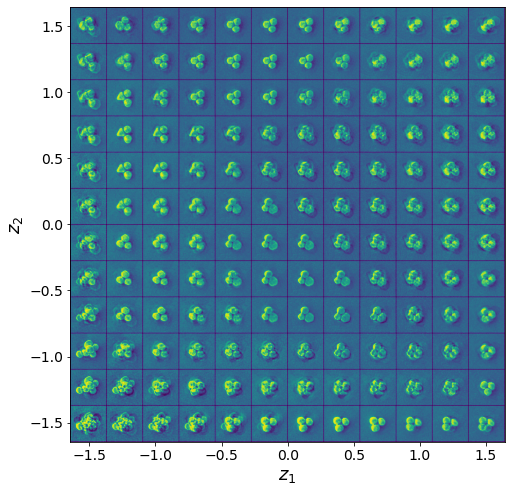

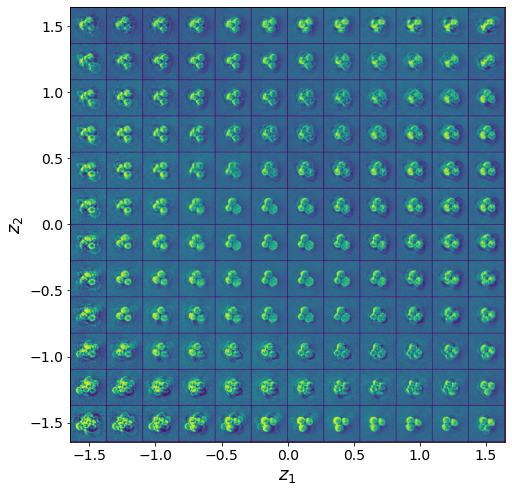

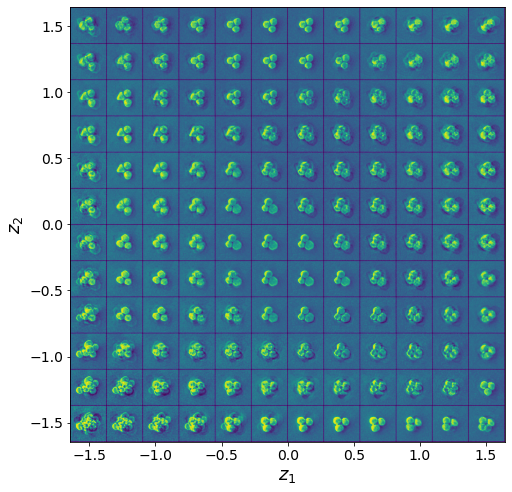

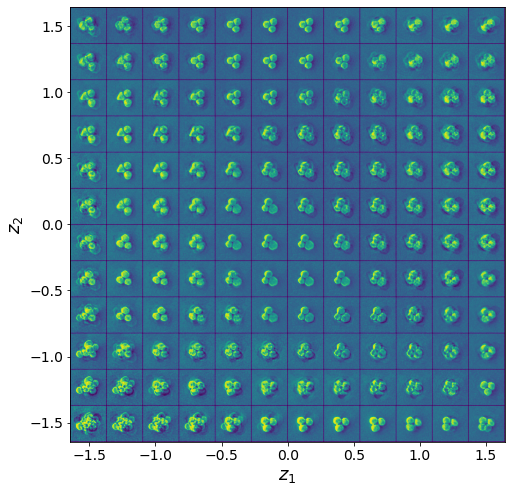

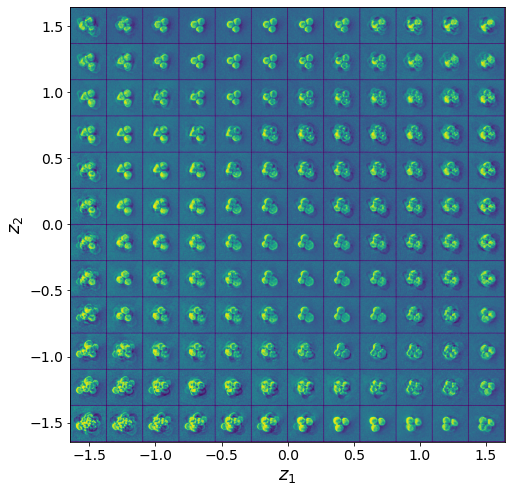

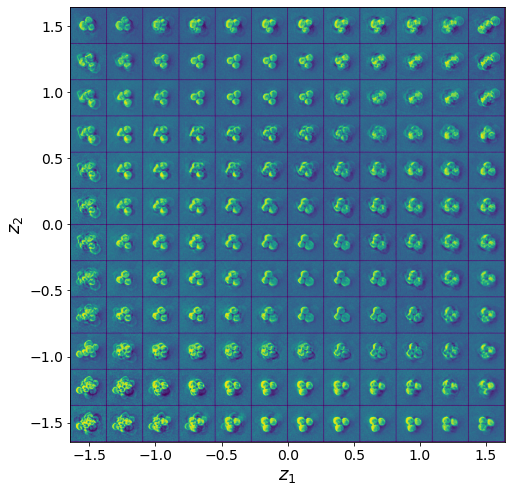

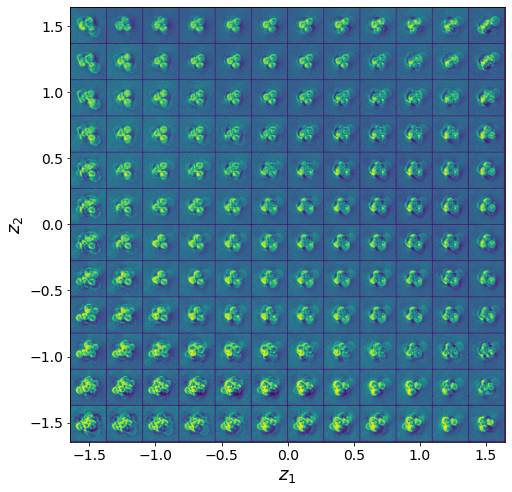

In [ ]:
for i in range(discrete_dim):
    jvae_full.manifold2d(d=B, disc_idx=i, cmap='viridis')

In [ ]:
#@title Train the jr-VAE model- use default kl_c
batch_size=64
B = 12 #grid size for manifold2D
#Data dim size
H = 96
W = 96
#Initialize # of discrete class
discrete_dim = 7
kl_d = 0.01

train_loader_full = pv.utils.init_dataloader(train_syndata_full, batch_size=64)

# Input data dimensions
data_dim = (H, W)

# Initialize joint VAE model (note that we have to enter our "guess" about the number of discrete classes in the system)
jvae_full = pv.models.jiVAE(data_dim, latent_dim=2, discrete_dim=discrete_dim, invariances=['r'], sampler_d='gaussian', seed=42, decoder_sig = 0.01, sigmoid_d=True )

# Initialize trainer (note that we are going to use parallel enumeration instead of Gumbel-Softmax approx)
trainer_full = pv.trainers.SVItrainer(jvae_full, lr=1e-4, enumerate_parallel=True)

#kl_d = kl_scale[-1]
kl_c = kl_optimal_est
#kl_c = torch.linspace(0.01, 0.04, 80)
kl_c = kl_c.type(torch.DoubleTensor)
#kl_trajec = torch.cat(25*[kl_c])


for e in range(200):
    #sc = kl_c[e] if e < len(kl_c) else kl_c[-1]
    sc = 1
    trainer_full.step(train_loader_full, scale_factor=[sc, kl_d])  # [continuous, discrete] KL scale factors for continuous latent vars optimized
    #trainer.print_statistics()

    # Plot the traversal of the latent manifold learned so far
    if (e + 1) % 20 == 0:
        print ("Manifold training at iter: " +str(e+1))
        for i in range(2):
            jvae_full.manifold_traversal(12, i, cmap='viridis')

# Learned Mnaifold  of Latent Var 1 -- Final iteration

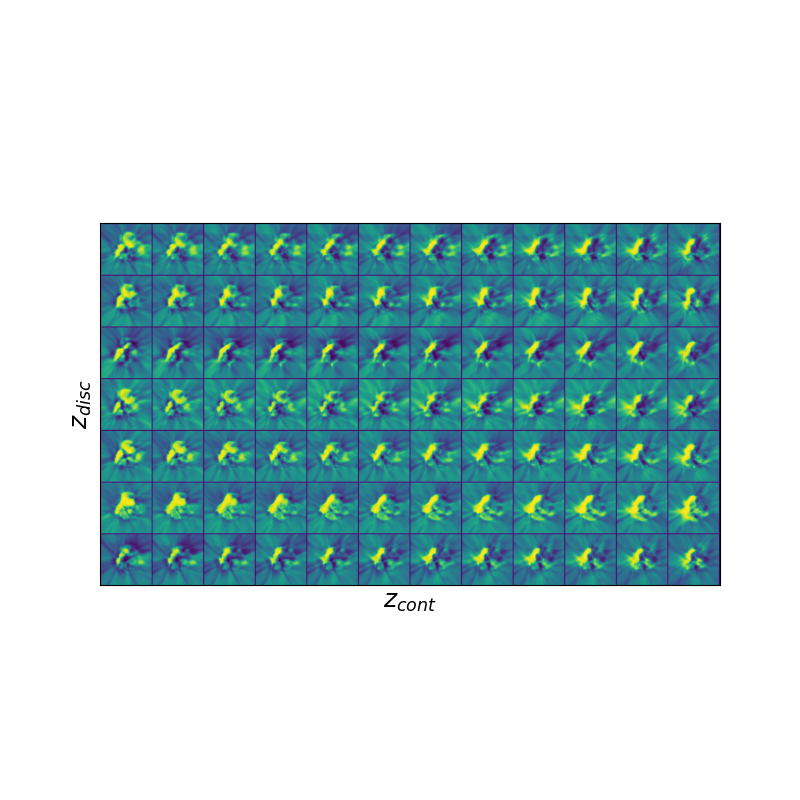

# Learned manifold of Latent Var 2- Final Iteration

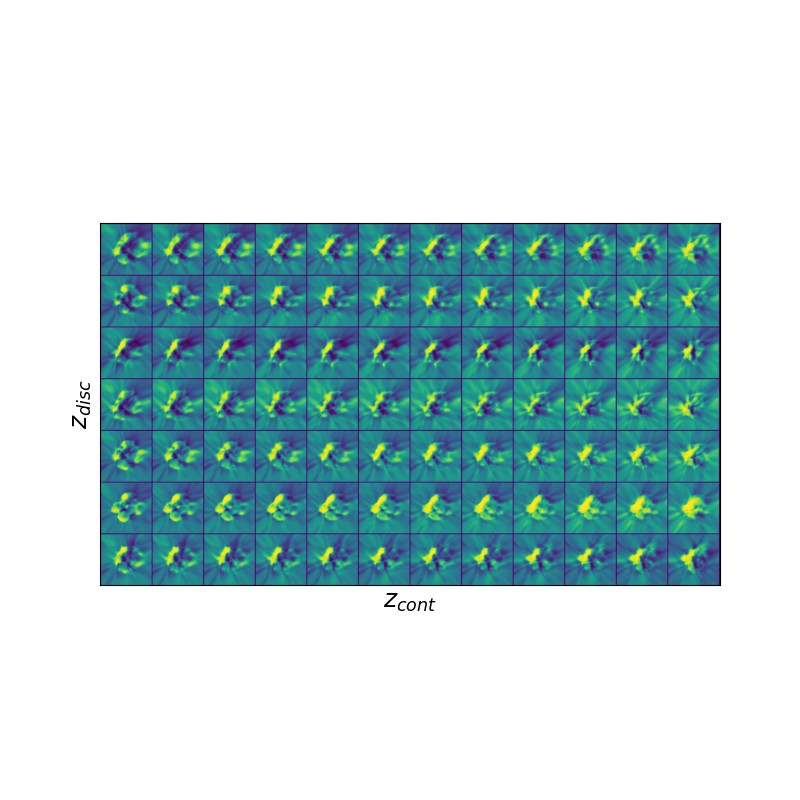